# pix2pix Model
## Direction：Satellite Image -> Google Map

In [10]:
from numpy import zeros
from numpy import ones
from numpy.random import randint
from tensorflow.keras.optimizers import Adam
from keras.initializers import RandomNormal
from keras.models import Model
from tensorflow.keras.layers import Input
from keras.layers import Conv2D
from keras.layers import Conv2DTranspose
from keras.layers import LeakyReLU
from keras.layers import Activation
from keras.layers import Concatenate
from keras.layers import Dropout
from keras.layers import BatchNormalization
from matplotlib import pyplot as plt
from tensorflow.keras.utils import plot_model
from os import listdir
from numpy import asarray, load
from numpy import vstack
from keras.preprocessing.image import img_to_array
from keras.preprocessing.image import load_img
from numpy import savez_compressed
from matplotlib import pyplot
import numpy as np
from datetime import datetime 
from keras.models import load_model
from numpy.random import randint
from skimage.metrics import peak_signal_noise_ratio as psnr
from skimage.metrics import structural_similarity as ssim
from skimage.transform import resize
from os.path import isfile, join

## 1.1 Discriminator

During training, the discriminator determines whether a Google Map comes from a real Google Map corresponding to a satellite image or a fake (generated) Google Map.

The discriminator uses PatchGAN. PatchGAN does not directly judge whether the entire image is real or fake; instead, it divides the image into multiple smaller patches and evaluates each patch independently.

Finally, by aggregating the results of all local patches, the discriminator outputs an overall judgment for the entire image: 1 indicates that the Google Map is real, and 0 indicates that it is fake.

In [2]:
# Define a discriminator model. The discriminator's task is to distinguish between generated images and real images.
def define_discriminator(image_shape):
    # Initialize convolutional kernel weights
    init = RandomNormal(stddev=0.02)  # Initialize weights using a normal distribution with stddev=0.02
    
    in_src_image = Input(shape=image_shape)  # in_src_image: input satellite image
    in_target_image = Input(shape=image_shape)  # in_target_image: the real Google Map corresponding to the satellite image
    
    # Concatenate the input satellite image and target map along the channel axis (depth)
    # Satellite image size: (256, 256, 3)
    # Real Google Map size: (256, 256, 3)
    # After concatenation, image shape becomes (256, 256, 6)
    # This allows the network to process both images together and learn the mapping from satellite to map
    merged = Concatenate()([in_src_image, in_target_image])
    
    # The discriminator uses a convolutional neural network to extract spatial features and assess whether the Google Map is real or fake
    # 64 filters, 4x4 kernel, stride 2x2, initialized with the defined random weights
    d = Conv2D(64, (4,4), strides=(2,2), padding='same', kernel_initializer=init)(merged)
    d = LeakyReLU(alpha=0.2)(d)  # LeakyReLU allows a small response for negative inputs (output = max(αx, x))
    
    # C128: 128 filters, 4x4 kernel, stride 2x2
    d = Conv2D(128, (4,4), strides=(2,2), padding='same', kernel_initializer=init)(d)
    d = BatchNormalization()(d)  # Normalizes layer inputs to mitigate vanishing/exploding gradients
    d = LeakyReLU(alpha=0.2)(d)
    
    # C256: 256 filters, 4x4 kernel, stride 2x2
    d = Conv2D(256, (4,4), strides=(2,2), padding='same', kernel_initializer=init)(d)
    d = BatchNormalization()(d)
    d = LeakyReLU(alpha=0.2)(d)
    
    # C512: 512 filters, 4x4 kernel, stride 2x2
    # Optional block; not in original paper. Can be commented out if not needed.
    d = Conv2D(512, (4,4), strides=(2,2), padding='same', kernel_initializer=init)(d)
    d = BatchNormalization()(d)
    d = LeakyReLU(alpha=0.2)(d)
    
    # Second last output layer: 512 filters, 4x4 kernel, stride 1x1
    d = Conv2D(512, (4,4), padding='same', kernel_initializer=init)(d)
    d = BatchNormalization()(d)
    d = LeakyReLU(alpha=0.2)(d)
    
    # Final output layer: compress multiple channels into 1 channel
    # Output shape: (batch_size, height, width, 1)
    d = Conv2D(1, (4,4), padding='same', kernel_initializer=init)(d)
    
    # Use sigmoid activation to map each element of d to [0,1]
    # patch_out shape: (batch_size, height, width, 1)
    patch_out = Activation('sigmoid')(d)
    
    # Define and compile the model
    # Model takes two inputs: source image (satellite) and target image (real Google Map)
    # Output: patch_out matrix, each element representing the authenticity score for a corresponding region in [0,1]
    model = Model([in_src_image, in_target_image], patch_out)
    
    # Use Adam optimizer with learning rate 0.0002
    opt = Adam(lr=0.0002, beta_1=0.5)
    # Binary cross-entropy loss is suitable for probability outputs (0 or 1)
    # loss_weights=[0.5] balances the contribution of discriminator and generator losses (50%-50%)
    model.compile(loss='binary_crossentropy', optimizer=opt, loss_weights=[0.5])
    
    return model


## 2.1 Generator

The generator uses a U-Net architecture.

The U-Net consists of an encoder for downsampling and a decoder for upsampling.

In [3]:
# Encoder block for downsampling: extracts complex features from the image while gradually reducing its spatial dimensions
'''
Parameters:
layer_in: input feature map from the previous layer
n_filters: number of filters in the convolution layer, determines the output feature map channels
batchnorm: whether to apply batch normalization after each convolution, helps accelerate convergence
'''
def encoder_block(layer_in, n_filters, batchnorm=True):
    # Initialize convolutional kernel weights
    init = RandomNormal(stddev=0.02)
    # 4x4 convolution for downsampling and feature extraction
    g = Conv2D(n_filters, (4,4), strides=(2,2), padding='same', kernel_initializer=init)(layer_in)
    # Apply batch normalization if specified
    if batchnorm:
        g = BatchNormalization()(g, training=True)
    # Use LeakyReLU activation
    g = LeakyReLU(alpha=0.2)(g)
    return g

'''
Parameters:
layer_in: input feature map
skip_in: skip connection from encoder
n_filters: number of filters
dropout: whether to apply dropout to prevent overfitting
'''
# Decoder block for upsampling: takes encoder features and combines them with skip connections to restore spatial details
def decoder_block(layer_in, skip_in, n_filters, dropout=True):
    # Initialize weights
    init = RandomNormal(stddev=0.02)
    # Transposed convolution (deconvolution) for upsampling
    g = Conv2DTranspose(n_filters, (4,4), strides=(2,2), padding='same', kernel_initializer=init)(layer_in)
    # Batch normalization
    g = BatchNormalization()(g, training=True)
    # Apply dropout if specified
    if dropout:
        g = Dropout(0.5)(g, training=True)
    # Concatenate decoder features with skip connection from encoder
    g = Concatenate()([g, skip_in])
    # ReLU activation
    g = Activation('relu')(g)
    return g

def define_generator(image_shape=(256,256,3)):
    # Initialize weights
    init = RandomNormal(stddev=0.02)
    # Input satellite image of size 256x256x3
    in_image = Input(shape=image_shape)
    
    # Encoder: series of convolution layers for downsampling and feature extraction
    e1 = encoder_block(in_image, 64, batchnorm=False)
    e2 = encoder_block(e1, 128)
    e3 = encoder_block(e2, 256)
    e4 = encoder_block(e3, 512)
    e5 = encoder_block(e4, 512)
    e6 = encoder_block(e5, 512)
    e7 = encoder_block(e6, 512)

    # Bottleneck layer: further abstracts the compressed information from the encoder
    b = Conv2D(512, (4,4), strides=(2,2), padding='same', kernel_initializer=init)(e7)
    b = Activation('relu')(b)

    # Decoder: upsampling while gradually restoring the image resolution using skip connections
    d1 = decoder_block(b, e7, 512)
    d2 = decoder_block(d1, e6, 512)
    d3 = decoder_block(d2, e5, 512)
    d4 = decoder_block(d3, e4, 512, dropout=False)
    d5 = decoder_block(d4, e3, 256, dropout=False)
    d6 = decoder_block(d5, e2, 128, dropout=False)
    d7 = decoder_block(d6, e1, 64, dropout=False)

    # Final upsampling to restore original resolution
    g = Conv2DTranspose(image_shape[2], (4,4), strides=(2,2), padding='same', kernel_initializer=init)(d7)

    # Use tanh activation to map output features to [-1,1], consistent with normalized input images
    out_image = Activation('tanh')(g)

    # in_image: satellite image; out_image: generated Google Map
    model = Model(in_image, out_image)
    return model


## 3.1 Define the Architecture for cGAN

In [4]:
# GAN accepts three parameters: generator model, discriminator model, and input image shape
def define_gan(g_model, d_model, image_shape):
    # When training the generator, we only update its weights and keep the discriminator's weights frozen
    # This prevents updates to the discriminator from interfering with generator training
    for layer in d_model.layers:
        if not isinstance(layer, BatchNormalization):
            layer.trainable = False  # Prevent discriminator parameters from being updated

    # Input image for this task is a satellite map
    in_src = Input(shape=image_shape)
    
    # Pass the satellite map through the generator to produce gen_out, which is the corresponding Google Map
    gen_out = g_model(in_src)
    
    # Pass the satellite map + generated Google Map into the discriminator to get the authenticity score dis_out
    # During training, the generator aims to make dis_out close to 1, i.e., the generated image looks real enough to fool the discriminator
    dis_out = d_model([in_src, gen_out])
    
    # Model inputs and outputs:
    # Input: in_src, the satellite image to be transformed
    # Outputs: [dis_out, gen_out]
    # - dis_out: discriminator's judgment of the generated map
    # - gen_out: generated Google Map
    model = Model(in_src, [dis_out, gen_out])
    
    # Compile the GAN model
    opt = Adam(lr=0.0002, beta_1=0.5)
    
    # Total loss is a weighted sum of adversarial loss (binary cross-entropy) and L1 loss (mean absolute error)
    # Authors suggest weighting BCE vs L1 as 1:100
    model.compile(loss=['binary_crossentropy', 'mae'], 
                  optimizer=opt, loss_weights=[1, 100])
    
    return model


In [5]:


# Generate real samples for training the discriminator
def generate_real_samples(dataset, n_samples, patch_shape):
    # Randomly select real samples from the dataset along with their labels
    # dataset contains two datasets, typically input-output image pairs
    # patch_shape is the size of the discriminator's output feature map

    trainA, trainB = dataset  # trainA: satellite images; trainB: corresponding target Google Maps

    # Randomly choose n_samples indices
    ix = randint(0, trainA.shape[0], n_samples)

    # Extract the images corresponding to selected indices
    # X1: random satellite images from trainA
    # X2: corresponding real Google Maps from trainB
    X1, X2 = trainA[ix], trainB[ix]

    # Create labels for real samples
    # y shape: (n_samples, patch_shape, patch_shape, 1)
    y = ones((n_samples, patch_shape, patch_shape, 1))

    # Return paired input-output images with labels
    return [X1, X2], y


# Generate fake samples using the generator for discriminator training
def generate_fake_samples(g_model, samples, patch_shape):
    # Use the generator model to produce fake images
    # Here, g_model predicts a Google Map from the input satellite images
    X = g_model.predict(samples)

    # Create labels for fake samples (0s)
    y = zeros((len(X), patch_shape, patch_shape, 1))

    return X, y


In [6]:

# During training, periodically generate sample images and save the generator model
def summarize_performance(step, g_model, dataset, n_samples=3):

    # Get real samples: satellite images and corresponding Google Maps
    [X_realA, X_realB], _ = generate_real_samples(dataset, n_samples, 1)
    
    # Use generator g_model to convert input satellite images X_realA into fake Google Maps X_fakeB
    X_fakeB, _ = generate_fake_samples(g_model, X_realA, 1)
    
    # Normalize pixel values from [-1,1] to [0,1] for display
    X_realA = (X_realA + 1) / 2.0
    X_realB = (X_realB + 1) / 2.0
    X_fakeB = (X_fakeB + 1) / 2.0

    # Plot images:
    # First row: real input satellite images (source images)
    for i in range(n_samples):
        plt.subplot(3, n_samples, 1 + i)
        plt.axis('off')
        plt.imshow(X_realA[i])
    
    # Second row: generated target Google Maps
    for i in range(n_samples):
        plt.subplot(3, n_samples, 1 + n_samples + i)
        plt.axis('off')
        plt.imshow(X_fakeB[i])
    
    # Third row: real target Google Maps
    for i in range(n_samples):
        plt.subplot(3, n_samples, 1 + n_samples*2 + i)
        plt.axis('off')
        plt.imshow(X_realB[i])

    # Save the plotted figure to file, using the current step in the filename
    filename1 = 'plot_%06d.png' % (step+1)
    plt.savefig(filename1)
    plt.close()

    # Save the generator model to file to preserve training state
    filename2 = 'model_%06d.h5' % (step+1)
    g_model.save(filename2)
    print('>Saved: %s and %s' % (filename1, filename2))


## Train

In [15]:
# Train the Pix2Pix models
def train(d_model, g_model, gan_model, dataset, n_epochs=100, n_batch=1):
    """
    d_model: discriminator model
    g_model: generator model
    gan_model: combined GAN model (generator + frozen discriminator)
    dataset: tuple of (source images, target images)
    n_epochs: total number of training epochs
    n_batch: batch size
    """
    # Patch size used by the discriminator output (PatchGAN)
    n_patch = d_model.output_shape[1]

    # Split the dataset into source (satellite) and target (Google Map) images
    trainA, trainB = dataset

    # Number of batches per epoch
    bat_per_epo = int(len(trainA) / n_batch)
    # Total training steps
    n_steps = bat_per_epo * n_epochs

    for i in range(n_steps):
        # print(f'Step[{i}]')

        # Get a batch of real samples and corresponding labels
        [X_realA, X_realB], y_real = generate_real_samples(dataset, n_batch, n_patch)

        # Generate fake samples using the generator and assign fake labels
        X_fakeB, y_fake = generate_fake_samples(g_model, X_realA, n_patch)

        # Train discriminator on real samples
        d_loss1 = d_model.train_on_batch([X_realA, X_realB], y_real)
        # Train discriminator on fake samples
        d_loss2 = d_model.train_on_batch([X_realA, X_fakeB], y_fake)

        # Train generator via GAN model
        # Generator tries to fool the discriminator (adversarial loss)
        # and match the target image (L1 loss)
        g_loss, _, _ = gan_model.train_on_batch(X_realA, [y_real, X_realB])

        # Every 50 steps, print training progress and visualize results
        if (i + 1) % 50 == 0:
            print('step[%d], d1_loss:[%.3f] d2_loss:[%.3f] generator_loss[%.3f]' %
                  (i + 1, d_loss1, d_loss2, g_loss))

            # Visualize one sample from the batch: source, generated, target
            sample_idx = 0  # Change to view other images
            src_image = (X_realA[sample_idx] + 1) / 2.0  # Normalize to [0,1]
            gen_image = (X_fakeB[sample_idx] + 1) / 2.0
            tar_image = (X_realB[sample_idx] + 1) / 2.0

            plt.figure(figsize=(10, 5))
            titles = ['Source', 'Generated', 'Target']
            images = [src_image, gen_image, tar_image]

            for j in range(3):
                plt.subplot(1, 3, j + 1)
                plt.imshow(images[j])
                plt.axis('off')
                plt.title(titles[j])

            plt.show()

        # Every 10 epochs, summarize performance and save model
        if (i + 1) % (bat_per_epo * 10) == 0:
            summarize_performance(i, g_model, dataset)


In [16]:
def load_images(path, size=(256,512)):
    src_list, tar_list = [], []
    
    for filename in listdir(path):
        full_path = join(path, filename)
        # Skip directories or non-image files
        if not isfile(full_path) or not filename.lower().endswith(('.png', '.jpg', '.jpeg')):
            continue
        
        # Load and split image
        pixels = load_img(full_path, target_size=size)
        pixels = img_to_array(pixels)
        
        sat_img, map_img = pixels[:, :256], pixels[:, 256:]
        src_list.append(sat_img)
        tar_list.append(map_img)
    
    return [asarray(src_list), asarray(tar_list)]

# Dataset path
path = 'maps/train/'

# Load dataset
[src_images, tar_images] = load_images(path)

# Print dataset shapes
print('Loaded: ', src_images.shape, tar_images.shape)


Loaded:  (1096, 256, 256, 3) (1096, 256, 256, 3)


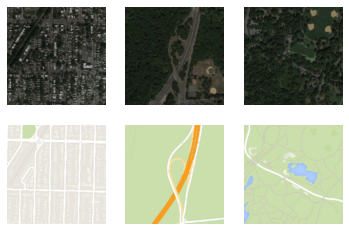

In [17]:
# Randomly select n_samples image pairs
n_samples = 3
random_indices = np.random.choice(src_images.shape[0], n_samples, replace=False)

# Get the randomly selected source (satellite) and target (map) images
src_images_sample = src_images[random_indices]
tar_images_sample = tar_images[random_indices]

# Plot the selected source images (satellite)
for i in range(n_samples):
    plt.subplot(2, n_samples, 1 + i)  # Layout: 2 rows, n_samples columns
    plt.axis('off')  # Hide axes
    plt.imshow(src_images_sample[i].astype('uint8'))  # Convert to uint8 for display

# Plot the corresponding target images (maps)
for i in range(n_samples):
    plt.subplot(2, n_samples, 1 + n_samples + i)  # Continue plotting in the second row
    plt.axis('off')
    plt.imshow(tar_images_sample[i].astype('uint8'))

# Display all images
plt.show()


step[50], d1_loss:[0.389] d2_loss:[0.461] generator_loss[25.166]


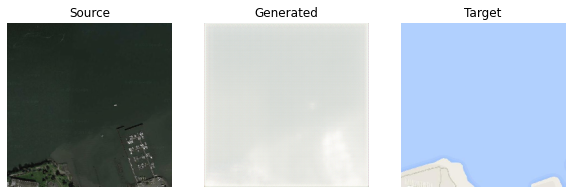

step[100], d1_loss:[0.087] d2_loss:[0.080] generator_loss[12.636]


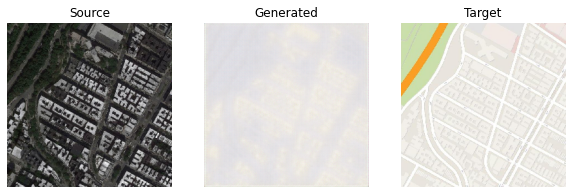

step[150], d1_loss:[0.167] d2_loss:[0.234] generator_loss[10.043]


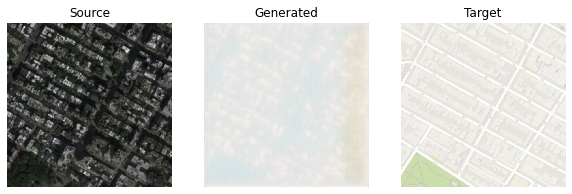

step[200], d1_loss:[0.672] d2_loss:[0.113] generator_loss[16.816]


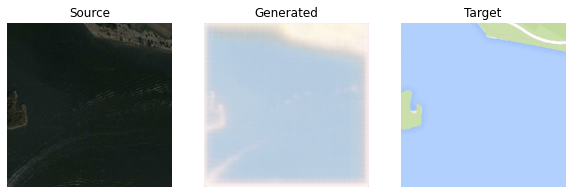

step[250], d1_loss:[0.008] d2_loss:[0.074] generator_loss[13.802]


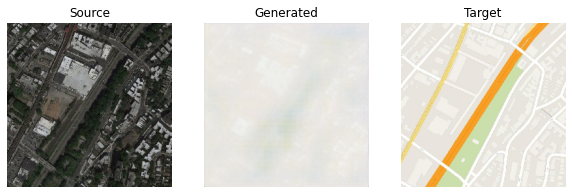

step[300], d1_loss:[0.387] d2_loss:[0.223] generator_loss[18.994]


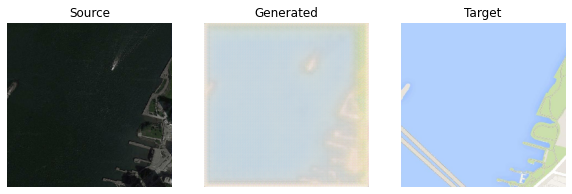

step[350], d1_loss:[0.012] d2_loss:[0.105] generator_loss[13.595]


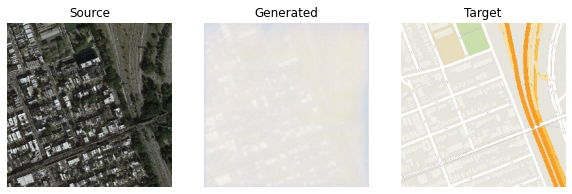

step[400], d1_loss:[0.013] d2_loss:[0.133] generator_loss[17.806]


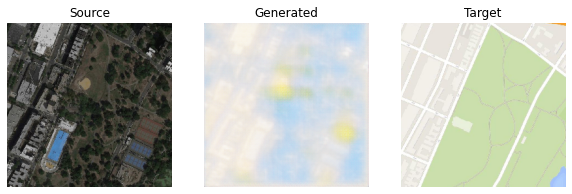

step[450], d1_loss:[0.208] d2_loss:[0.979] generator_loss[16.458]


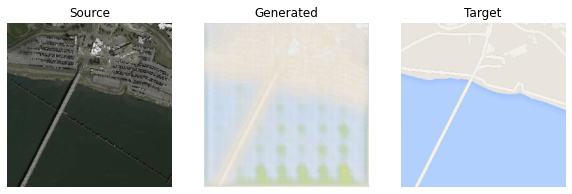

step[500], d1_loss:[0.236] d2_loss:[0.210] generator_loss[8.987]


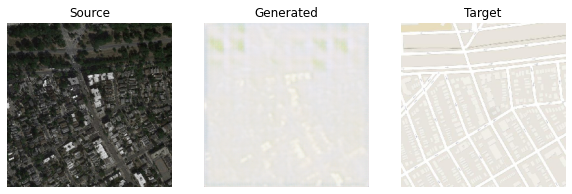

step[550], d1_loss:[0.203] d2_loss:[0.083] generator_loss[11.780]


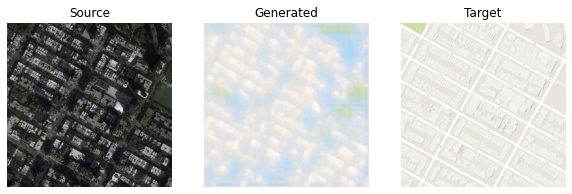

step[600], d1_loss:[0.592] d2_loss:[0.255] generator_loss[22.294]


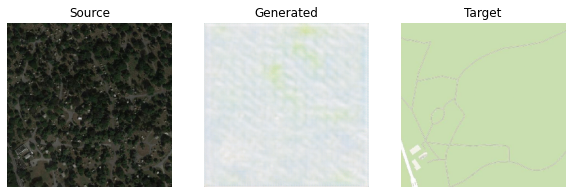

step[650], d1_loss:[0.006] d2_loss:[0.061] generator_loss[22.495]


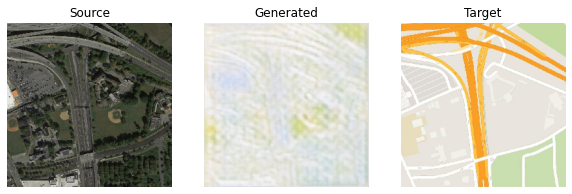

step[700], d1_loss:[0.023] d2_loss:[0.056] generator_loss[19.036]


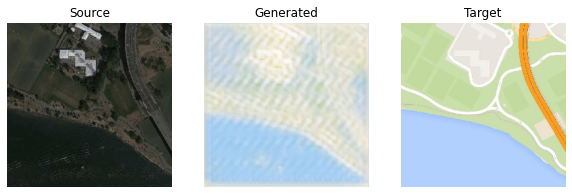

step[750], d1_loss:[0.053] d2_loss:[0.038] generator_loss[21.478]


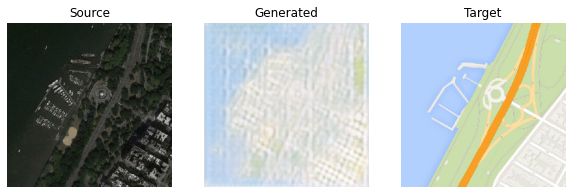

step[800], d1_loss:[0.005] d2_loss:[0.066] generator_loss[15.992]


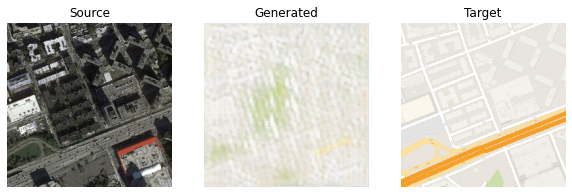

step[850], d1_loss:[0.021] d2_loss:[0.034] generator_loss[24.839]


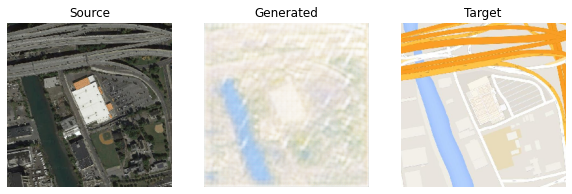

step[900], d1_loss:[0.176] d2_loss:[0.125] generator_loss[23.133]


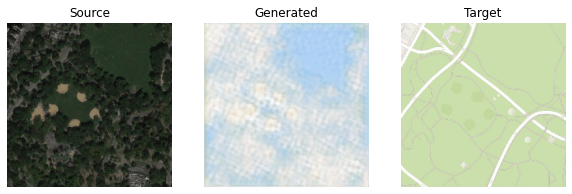

step[950], d1_loss:[0.093] d2_loss:[0.128] generator_loss[15.746]


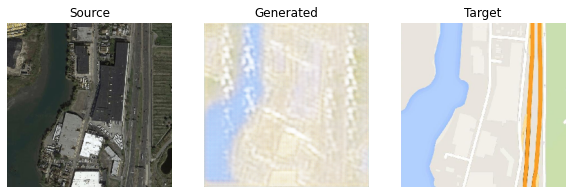

step[1000], d1_loss:[0.218] d2_loss:[0.243] generator_loss[11.465]


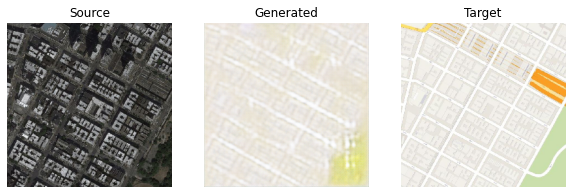

step[1050], d1_loss:[0.003] d2_loss:[0.254] generator_loss[11.308]


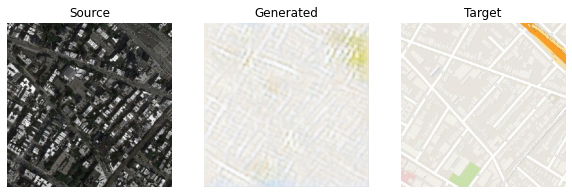

step[1100], d1_loss:[0.074] d2_loss:[0.159] generator_loss[9.656]


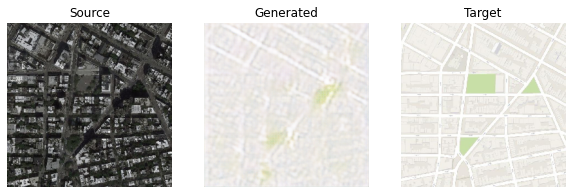

step[1150], d1_loss:[0.064] d2_loss:[0.127] generator_loss[22.402]


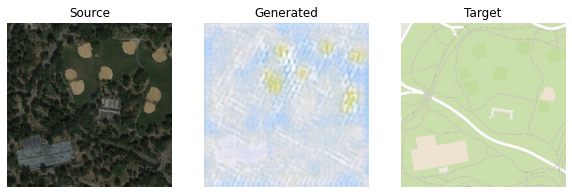

step[1200], d1_loss:[0.760] d2_loss:[0.197] generator_loss[12.032]


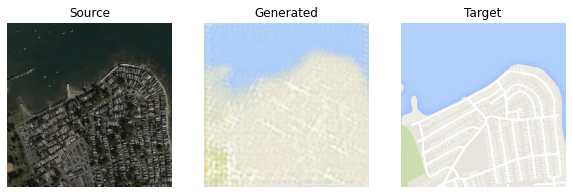

step[1250], d1_loss:[0.023] d2_loss:[0.179] generator_loss[8.596]


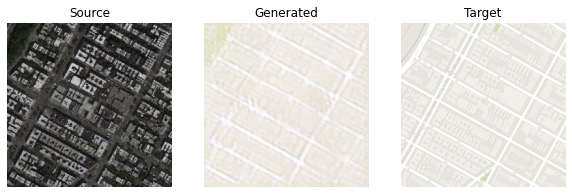

step[1300], d1_loss:[0.043] d2_loss:[0.096] generator_loss[18.513]


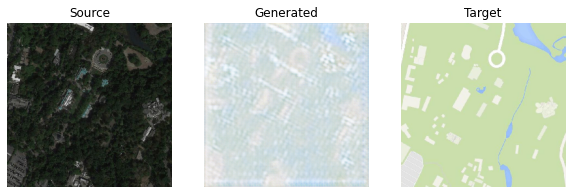

step[1350], d1_loss:[0.010] d2_loss:[0.144] generator_loss[16.300]


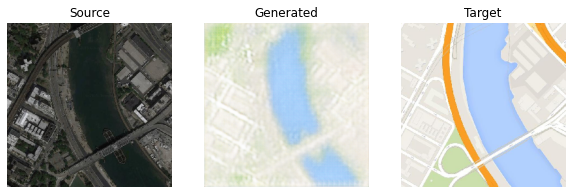

step[1400], d1_loss:[0.681] d2_loss:[0.362] generator_loss[9.482]


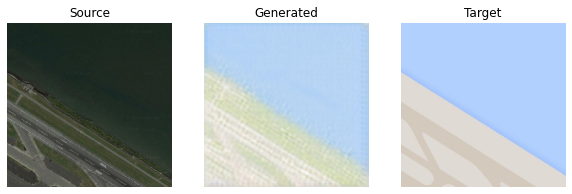

step[1450], d1_loss:[0.001] d2_loss:[0.296] generator_loss[16.014]


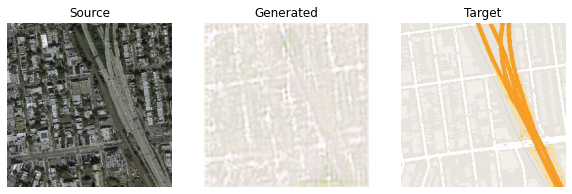

step[1500], d1_loss:[0.003] d2_loss:[0.040] generator_loss[19.352]


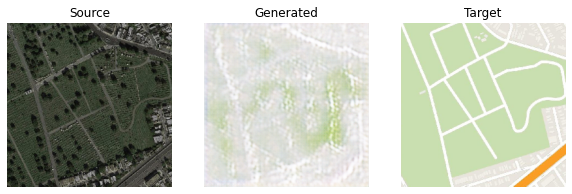

step[1550], d1_loss:[0.046] d2_loss:[0.142] generator_loss[12.638]


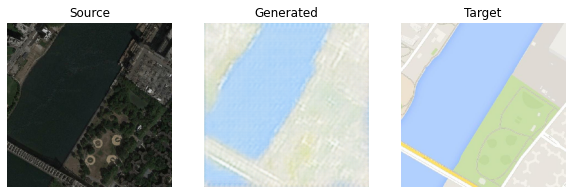

step[1600], d1_loss:[0.096] d2_loss:[0.088] generator_loss[9.832]


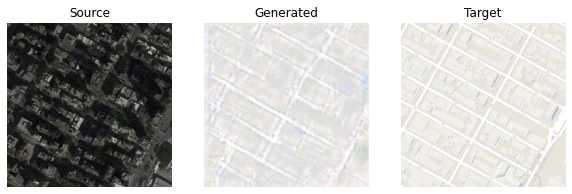

step[1650], d1_loss:[0.002] d2_loss:[0.077] generator_loss[12.499]


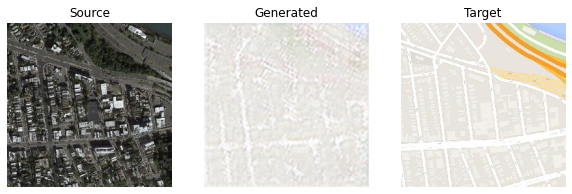

step[1700], d1_loss:[0.531] d2_loss:[0.182] generator_loss[8.274]


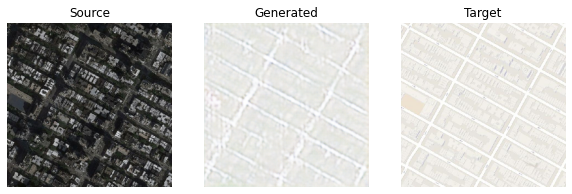

step[1750], d1_loss:[0.949] d2_loss:[0.170] generator_loss[7.903]


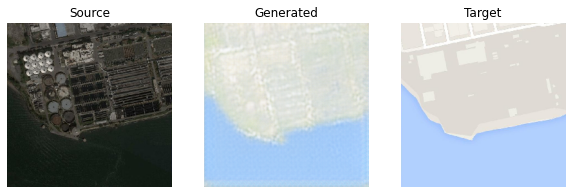

step[1800], d1_loss:[0.003] d2_loss:[0.137] generator_loss[12.867]


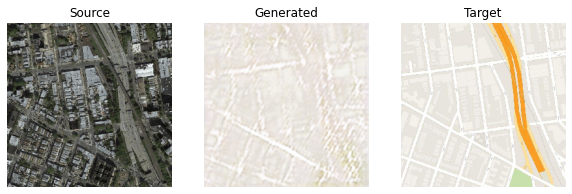

step[1850], d1_loss:[0.087] d2_loss:[0.118] generator_loss[10.082]


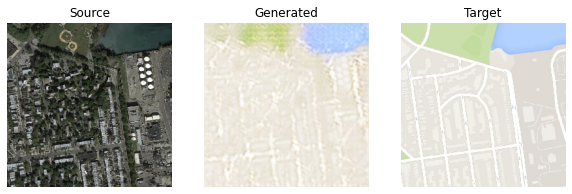

step[1900], d1_loss:[0.013] d2_loss:[0.053] generator_loss[18.957]


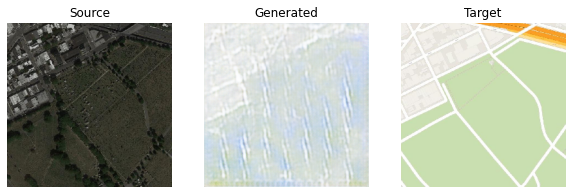

step[1950], d1_loss:[0.850] d2_loss:[0.180] generator_loss[10.653]


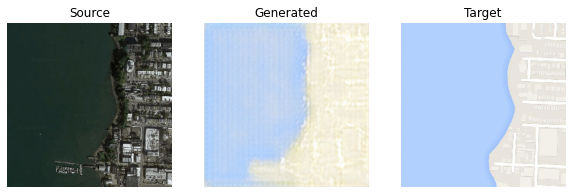

step[2000], d1_loss:[0.675] d2_loss:[0.507] generator_loss[12.569]


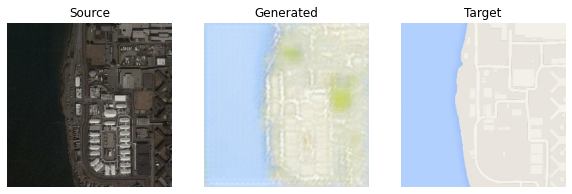

step[2050], d1_loss:[0.114] d2_loss:[0.098] generator_loss[9.296]


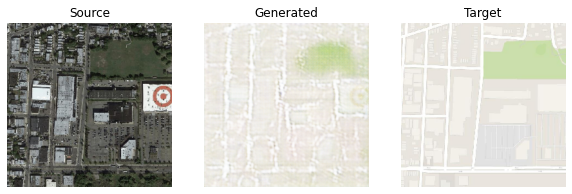

step[2100], d1_loss:[0.250] d2_loss:[0.224] generator_loss[9.886]


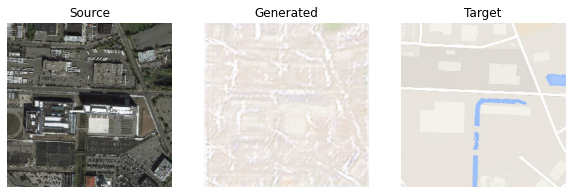

step[2150], d1_loss:[0.003] d2_loss:[0.076] generator_loss[25.096]


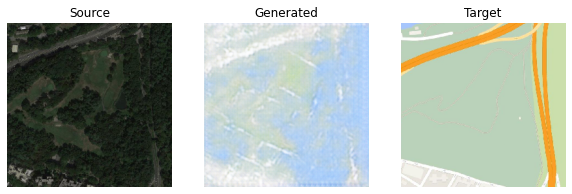

step[2200], d1_loss:[0.325] d2_loss:[0.127] generator_loss[11.750]


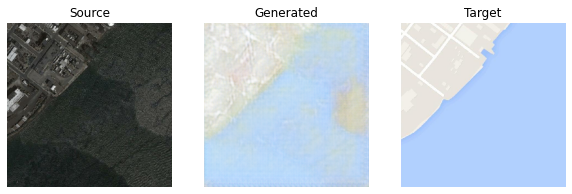

step[2250], d1_loss:[0.003] d2_loss:[0.053] generator_loss[13.426]


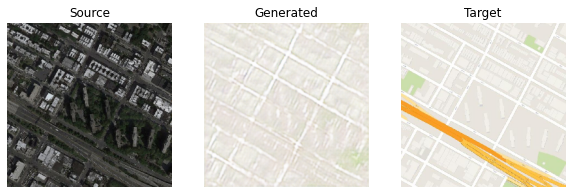

step[2300], d1_loss:[0.006] d2_loss:[0.033] generator_loss[19.482]


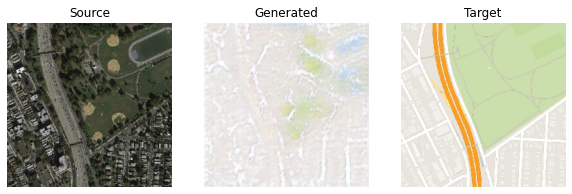

step[2350], d1_loss:[0.415] d2_loss:[0.467] generator_loss[14.796]


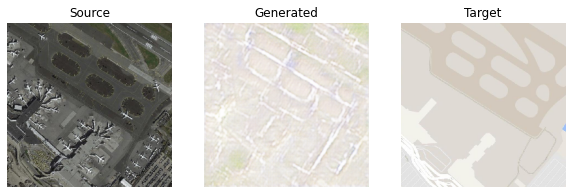

step[2400], d1_loss:[0.162] d2_loss:[0.113] generator_loss[7.819]


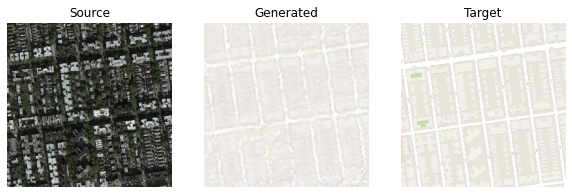

step[2450], d1_loss:[0.223] d2_loss:[0.116] generator_loss[20.077]


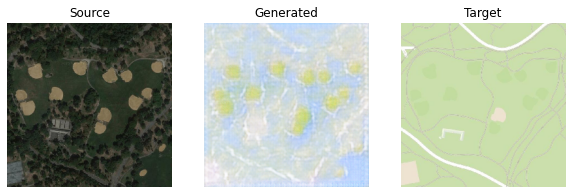

step[2500], d1_loss:[0.831] d2_loss:[0.178] generator_loss[7.603]


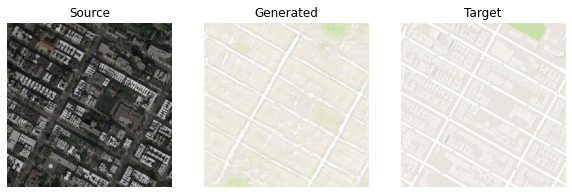

step[2550], d1_loss:[0.751] d2_loss:[0.223] generator_loss[10.407]


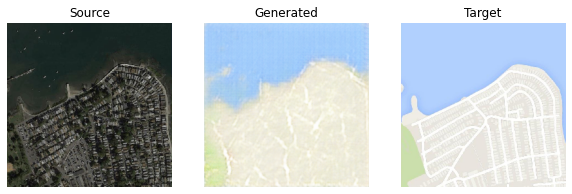

step[2600], d1_loss:[0.045] d2_loss:[0.216] generator_loss[9.878]


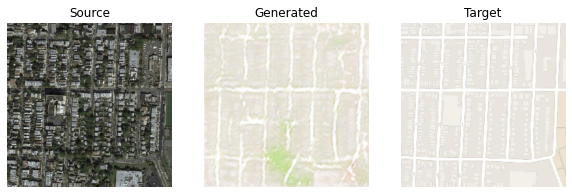

step[2650], d1_loss:[0.130] d2_loss:[0.086] generator_loss[10.644]


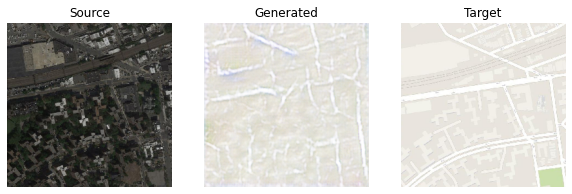

step[2700], d1_loss:[1.013] d2_loss:[0.322] generator_loss[9.712]


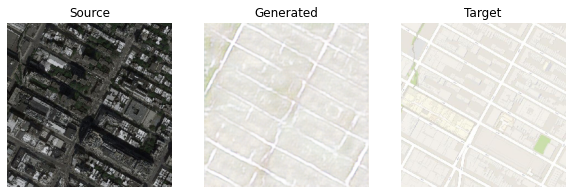

step[2750], d1_loss:[0.019] d2_loss:[0.051] generator_loss[14.598]


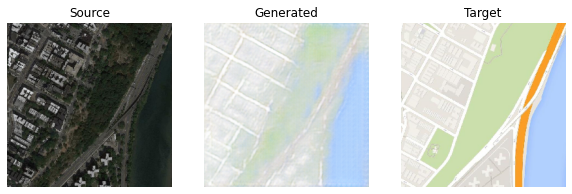

step[2800], d1_loss:[0.154] d2_loss:[0.072] generator_loss[17.083]


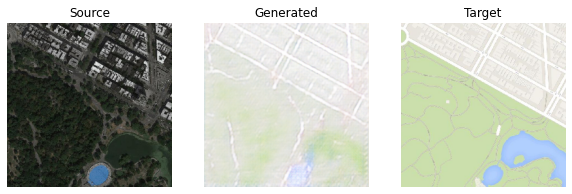

step[2850], d1_loss:[0.019] d2_loss:[0.053] generator_loss[13.752]


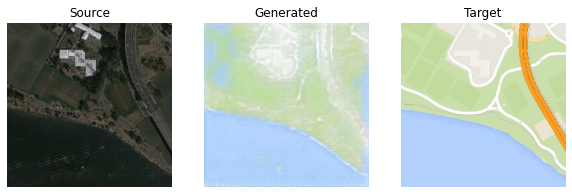

step[2900], d1_loss:[0.053] d2_loss:[0.118] generator_loss[11.286]


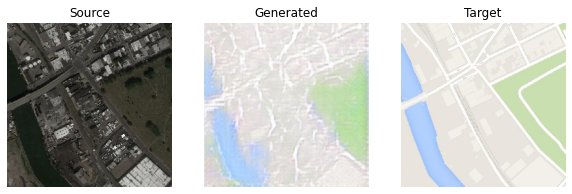

step[2950], d1_loss:[0.457] d2_loss:[0.198] generator_loss[8.022]


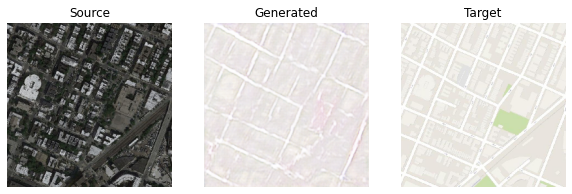

step[3000], d1_loss:[0.005] d2_loss:[0.173] generator_loss[14.001]


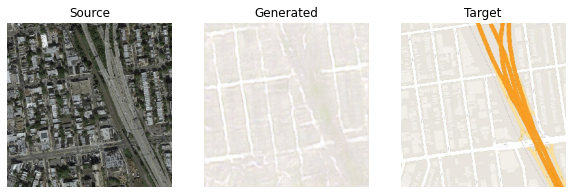

step[3050], d1_loss:[0.035] d2_loss:[0.053] generator_loss[16.588]


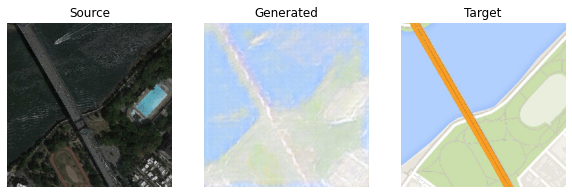

step[3100], d1_loss:[0.008] d2_loss:[0.057] generator_loss[13.795]


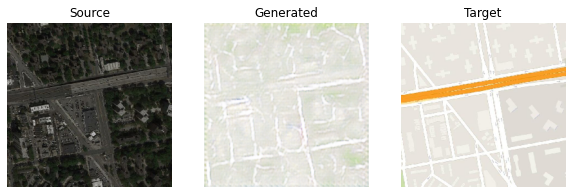

step[3150], d1_loss:[0.013] d2_loss:[0.091] generator_loss[15.669]


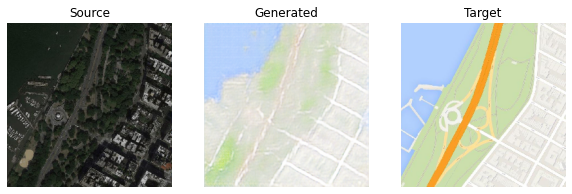

step[3200], d1_loss:[0.965] d2_loss:[0.129] generator_loss[9.097]


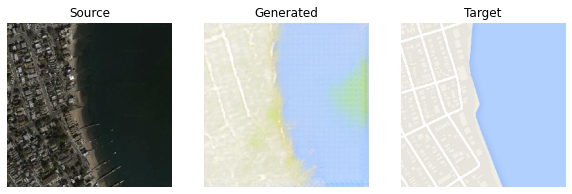

step[3250], d1_loss:[0.083] d2_loss:[0.166] generator_loss[7.968]


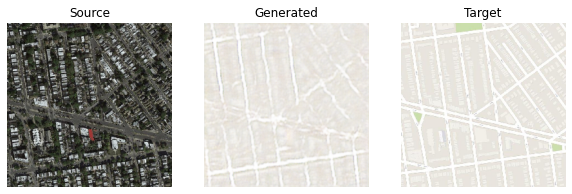

step[3300], d1_loss:[0.055] d2_loss:[0.095] generator_loss[14.309]


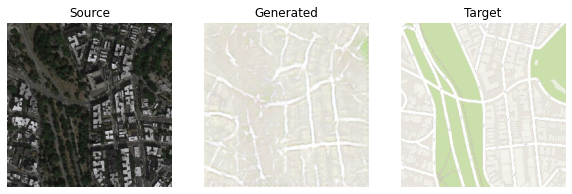

step[3350], d1_loss:[0.069] d2_loss:[0.113] generator_loss[10.410]


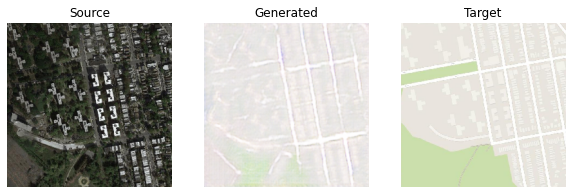

step[3400], d1_loss:[0.054] d2_loss:[0.097] generator_loss[13.094]


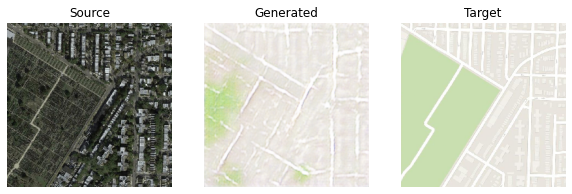

step[3450], d1_loss:[0.005] d2_loss:[0.167] generator_loss[11.954]


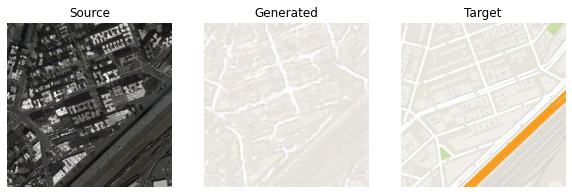

step[3500], d1_loss:[0.010] d2_loss:[0.060] generator_loss[12.580]


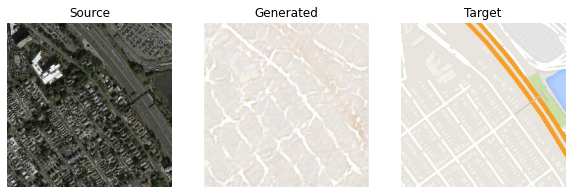

step[3550], d1_loss:[0.009] d2_loss:[0.097] generator_loss[10.056]


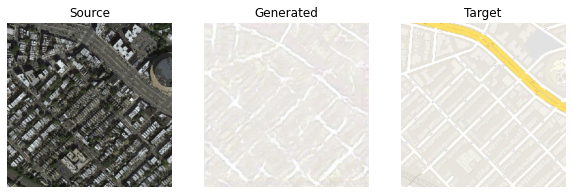

step[3600], d1_loss:[0.201] d2_loss:[0.239] generator_loss[9.241]


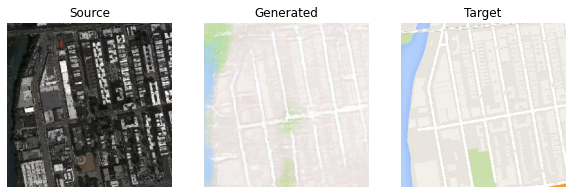

step[3650], d1_loss:[0.008] d2_loss:[0.126] generator_loss[12.752]


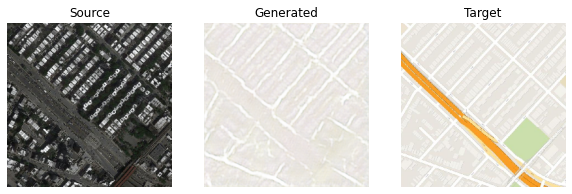

step[3700], d1_loss:[0.015] d2_loss:[0.094] generator_loss[12.385]


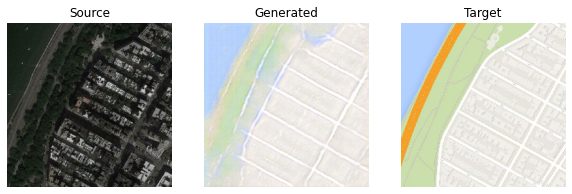

step[3750], d1_loss:[0.022] d2_loss:[0.033] generator_loss[8.211]


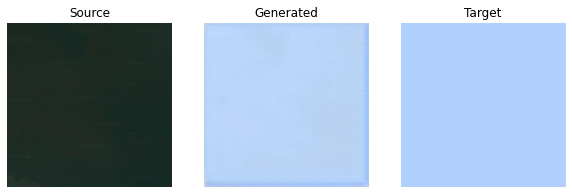

step[3800], d1_loss:[0.011] d2_loss:[0.064] generator_loss[11.499]


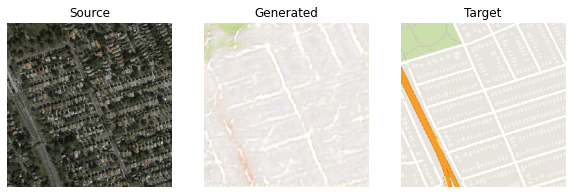

step[3850], d1_loss:[0.017] d2_loss:[0.064] generator_loss[9.741]


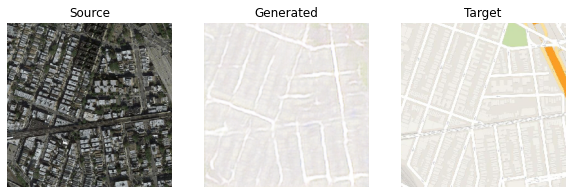

step[3900], d1_loss:[0.259] d2_loss:[0.256] generator_loss[8.802]


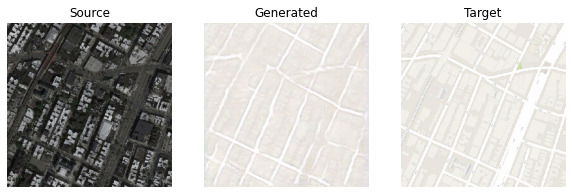

step[3950], d1_loss:[0.041] d2_loss:[0.108] generator_loss[14.224]


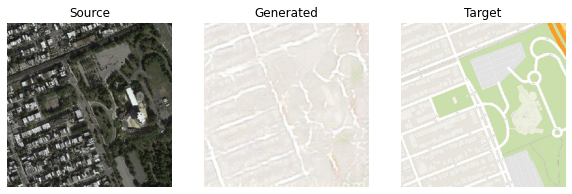

step[4000], d1_loss:[0.020] d2_loss:[0.133] generator_loss[12.524]


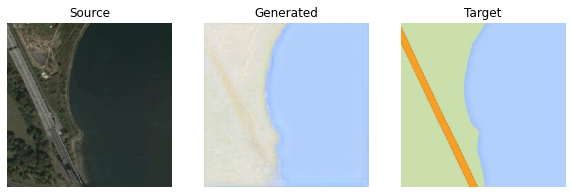

step[4050], d1_loss:[0.174] d2_loss:[0.095] generator_loss[9.731]


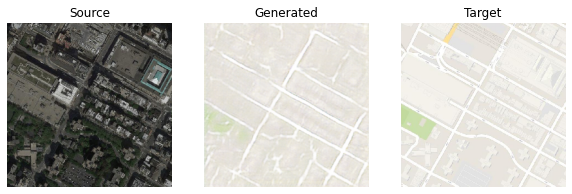

step[4100], d1_loss:[0.697] d2_loss:[0.093] generator_loss[8.586]


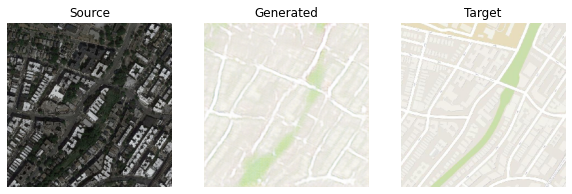

step[4150], d1_loss:[0.659] d2_loss:[0.067] generator_loss[11.300]


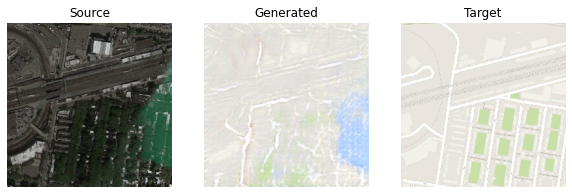

step[4200], d1_loss:[0.212] d2_loss:[0.207] generator_loss[13.247]


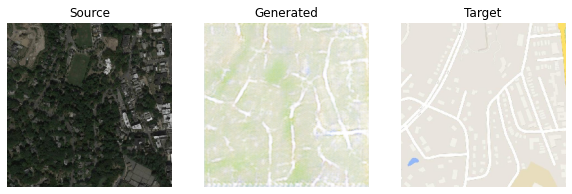

step[4250], d1_loss:[0.296] d2_loss:[0.333] generator_loss[8.655]


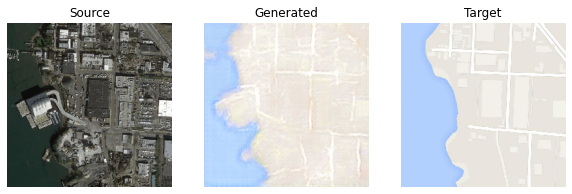

step[4300], d1_loss:[0.016] d2_loss:[0.059] generator_loss[15.238]


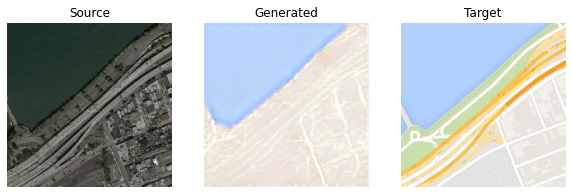

step[4350], d1_loss:[0.030] d2_loss:[0.109] generator_loss[10.745]


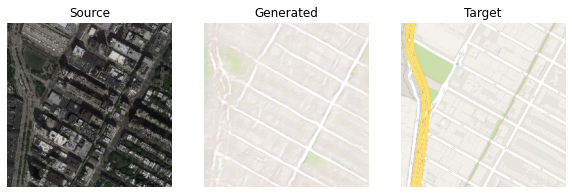

step[4400], d1_loss:[0.040] d2_loss:[0.167] generator_loss[10.612]


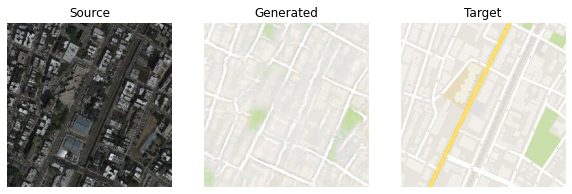

step[4450], d1_loss:[0.041] d2_loss:[0.328] generator_loss[8.353]


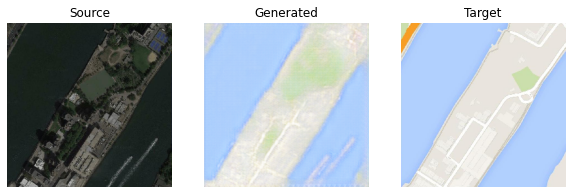

step[4500], d1_loss:[0.317] d2_loss:[0.325] generator_loss[7.046]


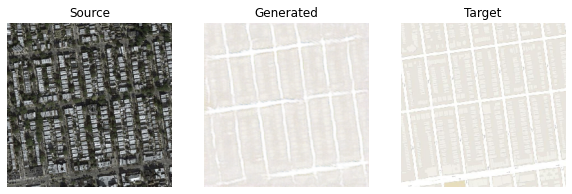

step[4550], d1_loss:[0.042] d2_loss:[0.062] generator_loss[10.487]


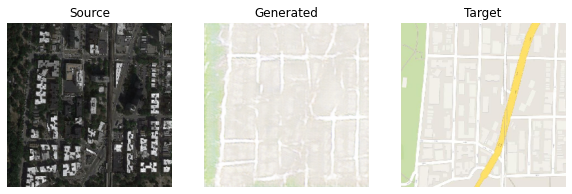

step[4600], d1_loss:[0.022] d2_loss:[0.072] generator_loss[10.272]


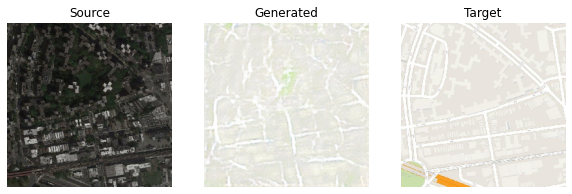

step[4650], d1_loss:[0.019] d2_loss:[0.071] generator_loss[24.389]


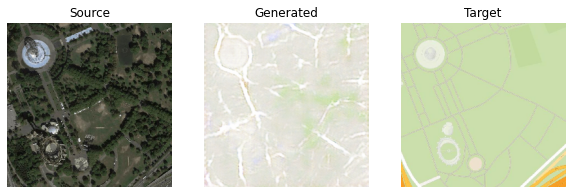

step[4700], d1_loss:[0.022] d2_loss:[0.117] generator_loss[8.008]


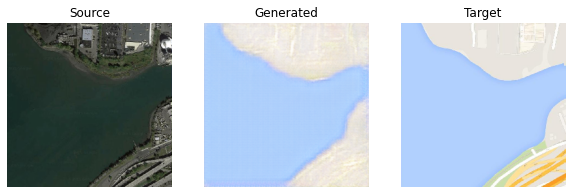

step[4750], d1_loss:[0.138] d2_loss:[0.123] generator_loss[8.084]


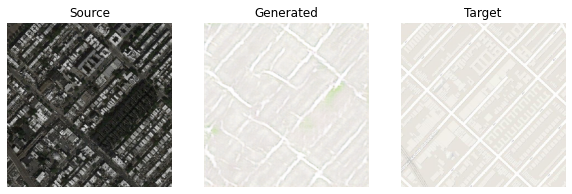

step[4800], d1_loss:[0.248] d2_loss:[0.430] generator_loss[7.998]


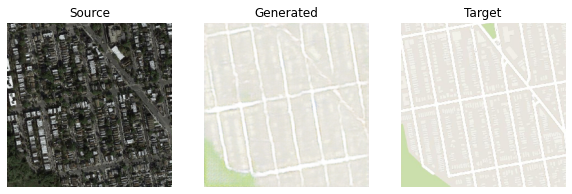

step[4850], d1_loss:[0.020] d2_loss:[0.540] generator_loss[13.146]


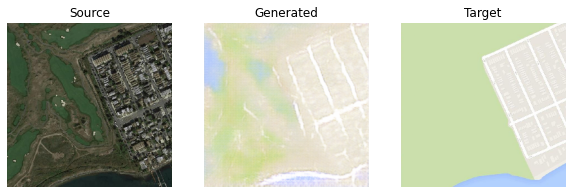

step[4900], d1_loss:[0.524] d2_loss:[0.225] generator_loss[7.491]


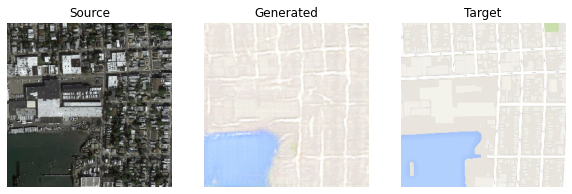

step[4950], d1_loss:[0.011] d2_loss:[0.052] generator_loss[14.396]


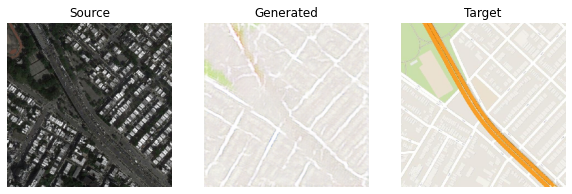

step[5000], d1_loss:[0.008] d2_loss:[0.181] generator_loss[9.198]


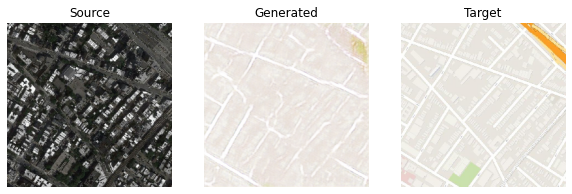

step[5050], d1_loss:[0.149] d2_loss:[0.092] generator_loss[14.914]


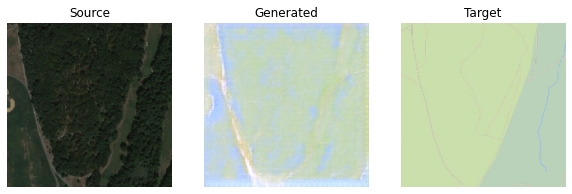

step[5100], d1_loss:[0.010] d2_loss:[0.053] generator_loss[14.148]


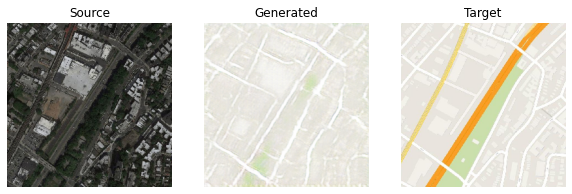

step[5150], d1_loss:[0.041] d2_loss:[0.100] generator_loss[9.479]


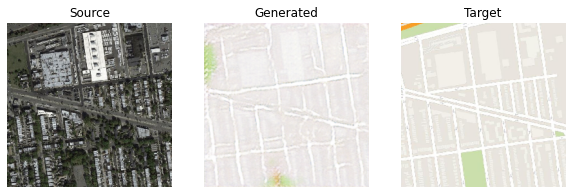

step[5200], d1_loss:[0.747] d2_loss:[0.589] generator_loss[5.783]


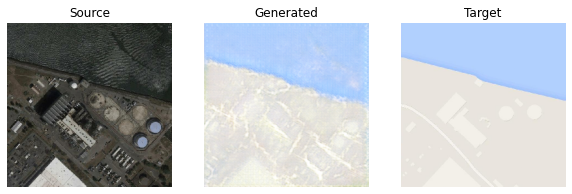

step[5250], d1_loss:[0.594] d2_loss:[0.274] generator_loss[10.450]


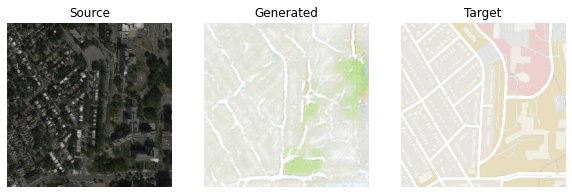

step[5300], d1_loss:[0.436] d2_loss:[0.225] generator_loss[7.875]


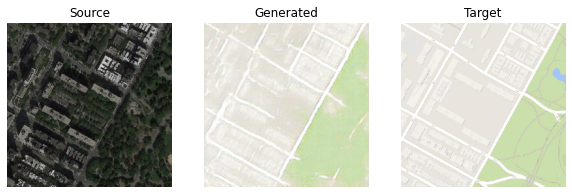

step[5350], d1_loss:[0.008] d2_loss:[0.065] generator_loss[13.260]


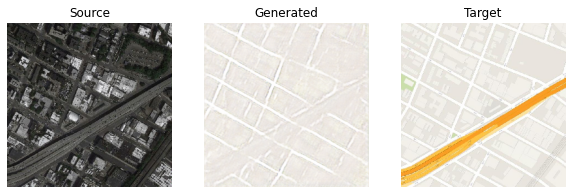

step[5400], d1_loss:[0.710] d2_loss:[0.316] generator_loss[13.841]


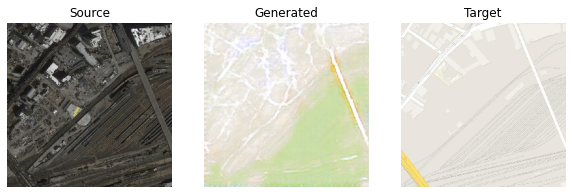

step[5450], d1_loss:[0.107] d2_loss:[0.431] generator_loss[9.100]


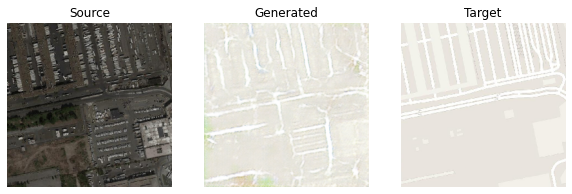

step[5500], d1_loss:[0.667] d2_loss:[0.346] generator_loss[7.472]


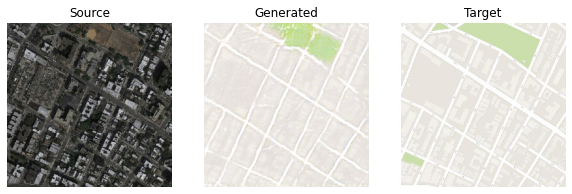

step[5550], d1_loss:[0.009] d2_loss:[0.167] generator_loss[11.019]


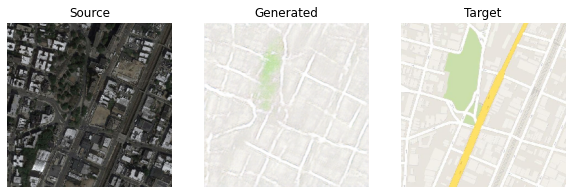

step[5600], d1_loss:[0.014] d2_loss:[0.091] generator_loss[12.419]


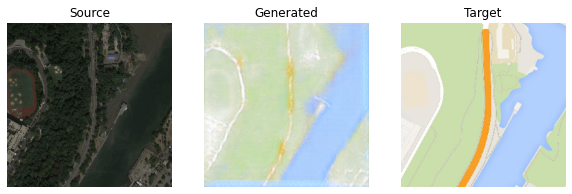

step[5650], d1_loss:[0.187] d2_loss:[0.227] generator_loss[8.423]


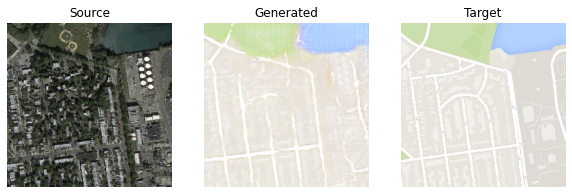

step[5700], d1_loss:[0.013] d2_loss:[0.075] generator_loss[10.749]


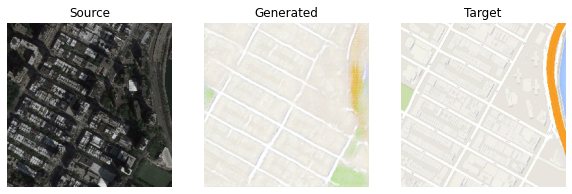

step[5750], d1_loss:[0.409] d2_loss:[0.903] generator_loss[8.623]


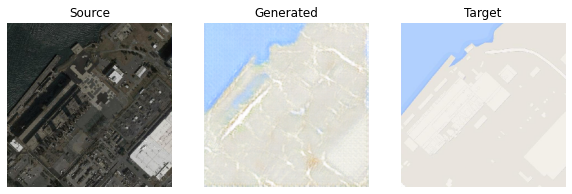

step[5800], d1_loss:[0.099] d2_loss:[0.207] generator_loss[8.116]


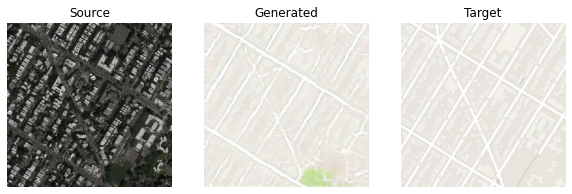

step[5850], d1_loss:[0.120] d2_loss:[0.079] generator_loss[10.489]


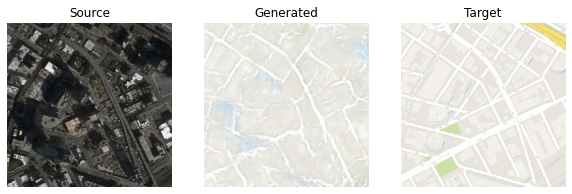

step[5900], d1_loss:[0.147] d2_loss:[0.188] generator_loss[8.766]


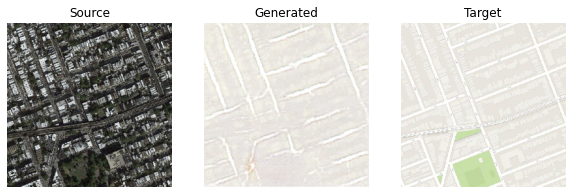

step[5950], d1_loss:[0.360] d2_loss:[0.146] generator_loss[7.711]


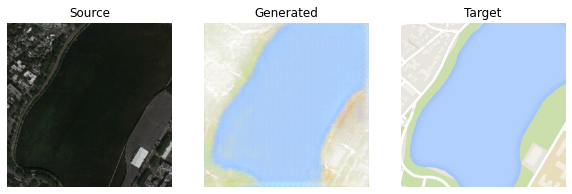

step[6000], d1_loss:[0.044] d2_loss:[0.146] generator_loss[7.648]


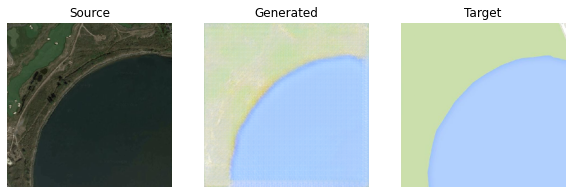

step[6050], d1_loss:[0.064] d2_loss:[0.046] generator_loss[13.379]


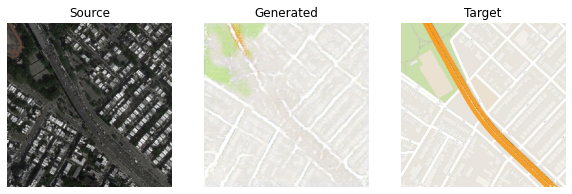

step[6100], d1_loss:[0.297] d2_loss:[0.203] generator_loss[9.970]


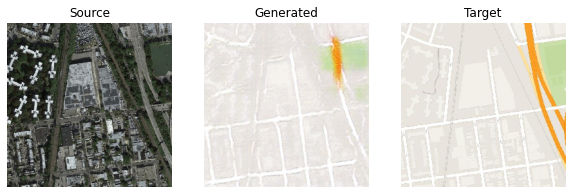

step[6150], d1_loss:[0.009] d2_loss:[0.259] generator_loss[10.497]


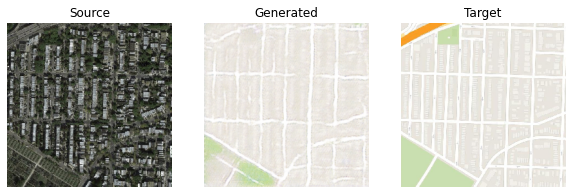

step[6200], d1_loss:[0.444] d2_loss:[0.214] generator_loss[7.513]


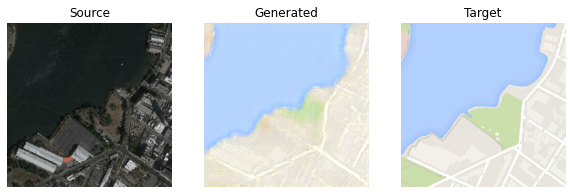

step[6250], d1_loss:[0.010] d2_loss:[0.116] generator_loss[4.819]


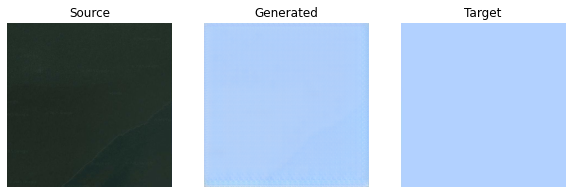

step[6300], d1_loss:[0.133] d2_loss:[0.082] generator_loss[7.655]


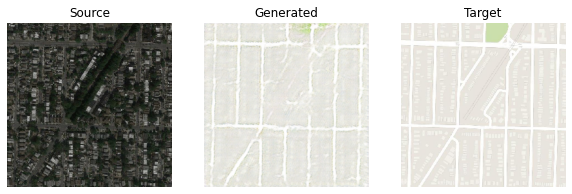

step[6350], d1_loss:[0.025] d2_loss:[0.071] generator_loss[13.410]


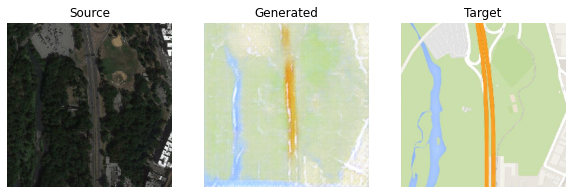

step[6400], d1_loss:[0.025] d2_loss:[0.084] generator_loss[14.224]


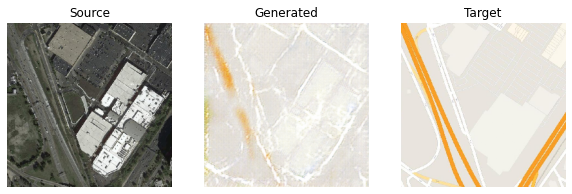

step[6450], d1_loss:[0.017] d2_loss:[0.040] generator_loss[14.191]


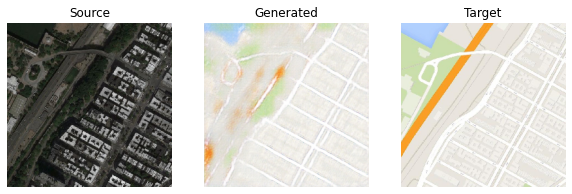

step[6500], d1_loss:[0.375] d2_loss:[0.185] generator_loss[7.688]


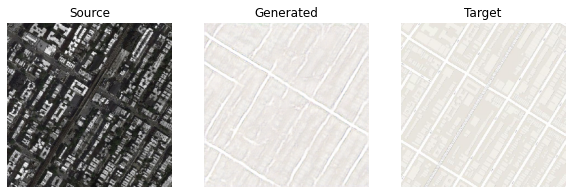

step[6550], d1_loss:[0.033] d2_loss:[0.201] generator_loss[11.792]


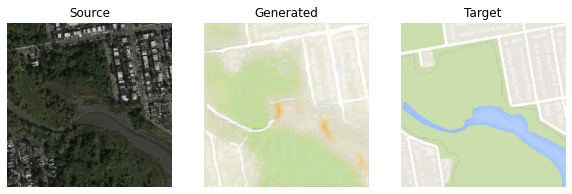

step[6600], d1_loss:[0.264] d2_loss:[0.052] generator_loss[10.074]


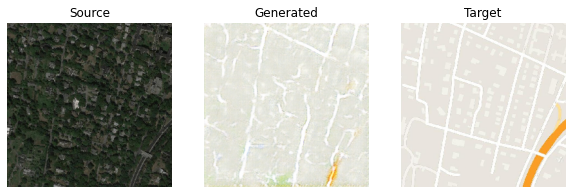

step[6650], d1_loss:[0.009] d2_loss:[0.082] generator_loss[11.406]


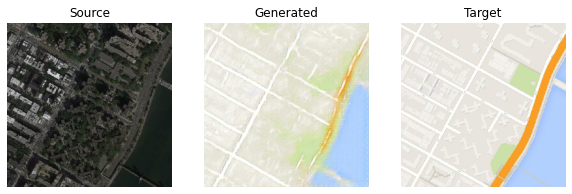

step[6700], d1_loss:[0.033] d2_loss:[0.493] generator_loss[5.336]


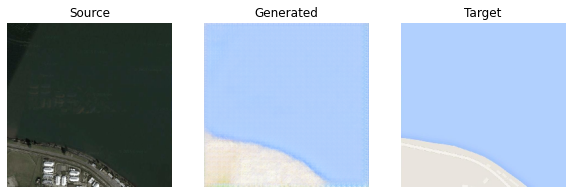

step[6750], d1_loss:[0.027] d2_loss:[0.300] generator_loss[9.732]


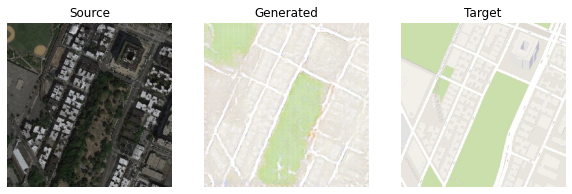

step[6800], d1_loss:[1.062] d2_loss:[0.077] generator_loss[8.923]


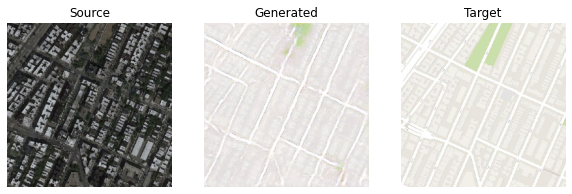

step[6850], d1_loss:[0.605] d2_loss:[0.180] generator_loss[9.368]


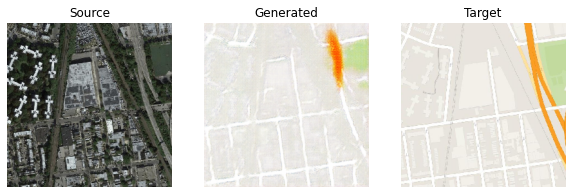

step[6900], d1_loss:[0.024] d2_loss:[0.119] generator_loss[9.968]


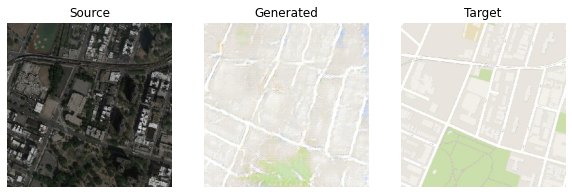

step[6950], d1_loss:[0.048] d2_loss:[0.074] generator_loss[10.005]


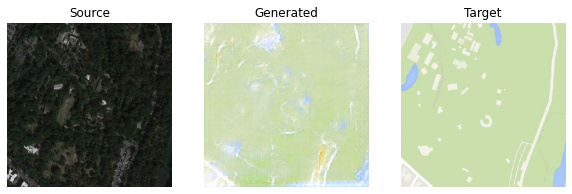

step[7000], d1_loss:[0.279] d2_loss:[0.164] generator_loss[7.692]


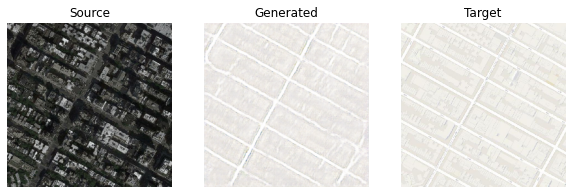

step[7050], d1_loss:[0.111] d2_loss:[0.733] generator_loss[8.266]


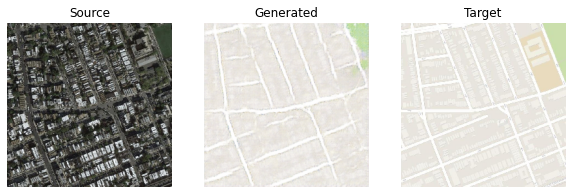

step[7100], d1_loss:[0.513] d2_loss:[0.109] generator_loss[9.435]


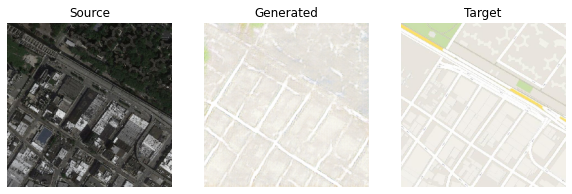

step[7150], d1_loss:[0.072] d2_loss:[0.093] generator_loss[10.562]


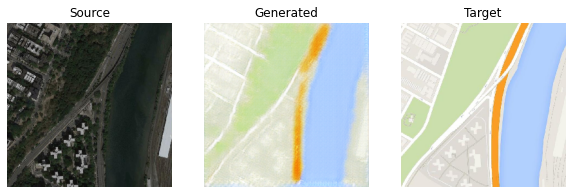

step[7200], d1_loss:[0.032] d2_loss:[0.090] generator_loss[15.388]


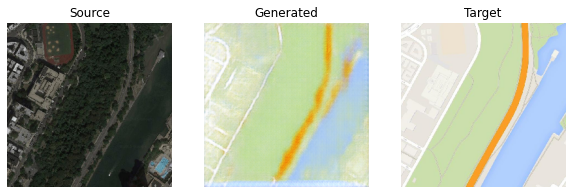

step[7250], d1_loss:[0.180] d2_loss:[0.143] generator_loss[8.938]


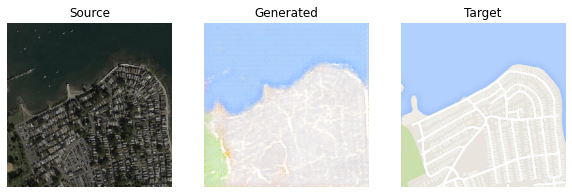

step[7300], d1_loss:[0.132] d2_loss:[0.257] generator_loss[8.643]


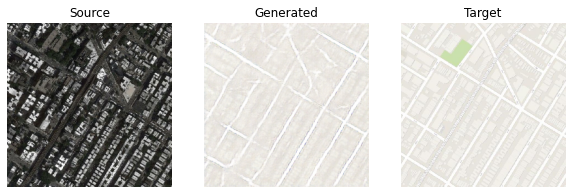

step[7350], d1_loss:[1.273] d2_loss:[0.106] generator_loss[10.200]


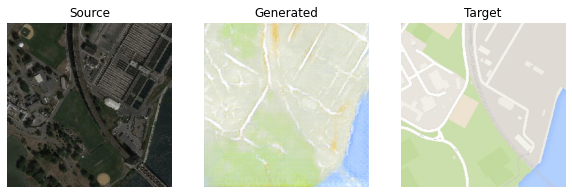

step[7400], d1_loss:[0.074] d2_loss:[0.440] generator_loss[13.069]


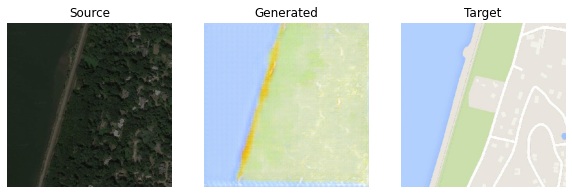

step[7450], d1_loss:[0.123] d2_loss:[0.058] generator_loss[15.413]


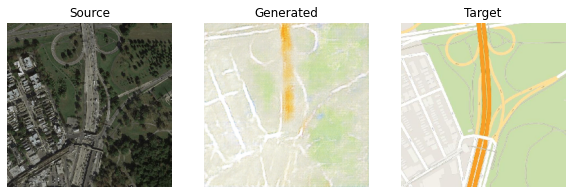

step[7500], d1_loss:[0.061] d2_loss:[0.255] generator_loss[8.619]


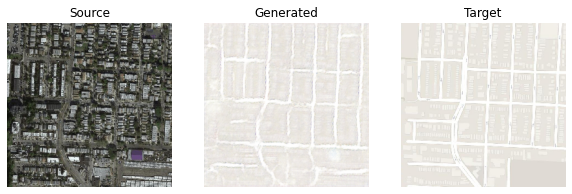

step[7550], d1_loss:[0.014] d2_loss:[0.063] generator_loss[13.813]


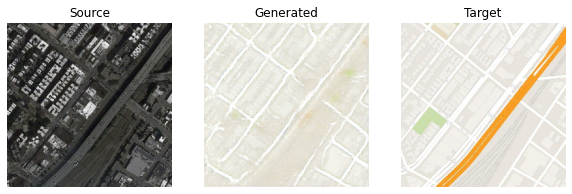

step[7600], d1_loss:[0.391] d2_loss:[0.338] generator_loss[9.520]


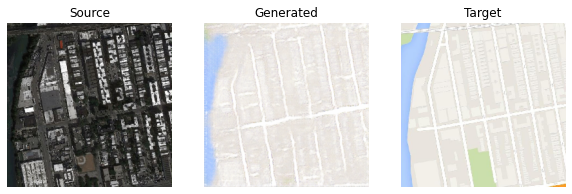

step[7650], d1_loss:[0.015] d2_loss:[0.354] generator_loss[11.311]


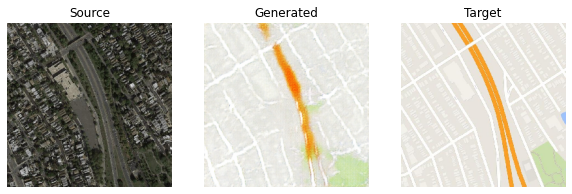

step[7700], d1_loss:[0.264] d2_loss:[0.242] generator_loss[7.492]


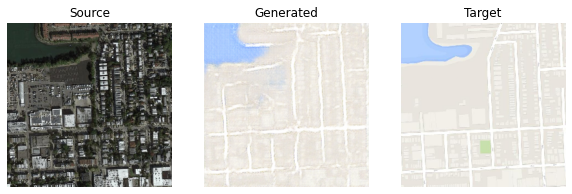

step[7750], d1_loss:[0.065] d2_loss:[0.215] generator_loss[9.392]


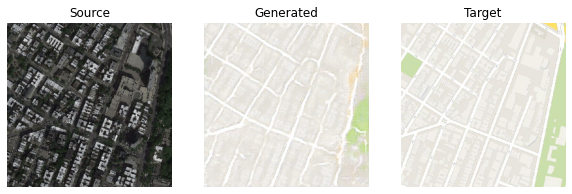

step[7800], d1_loss:[1.575] d2_loss:[0.082] generator_loss[6.515]


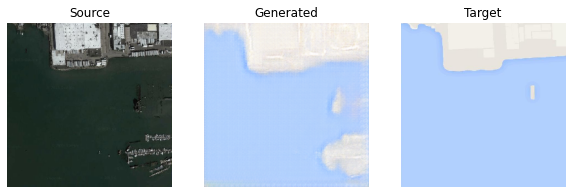

step[7850], d1_loss:[0.094] d2_loss:[0.132] generator_loss[7.924]


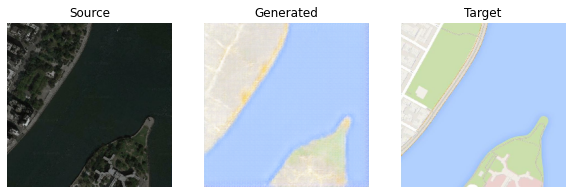

step[7900], d1_loss:[0.098] d2_loss:[0.158] generator_loss[9.389]


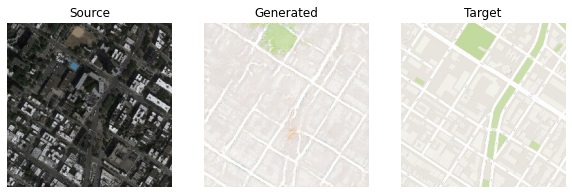

step[7950], d1_loss:[0.021] d2_loss:[0.231] generator_loss[13.186]


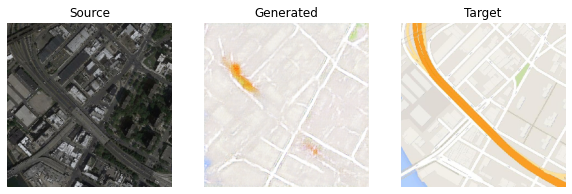

step[8000], d1_loss:[0.521] d2_loss:[0.265] generator_loss[7.941]


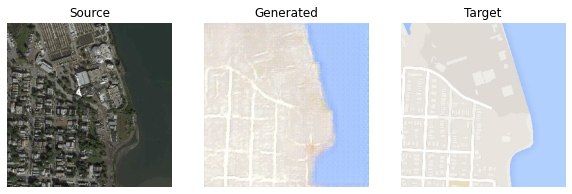

step[8050], d1_loss:[0.059] d2_loss:[0.130] generator_loss[9.380]


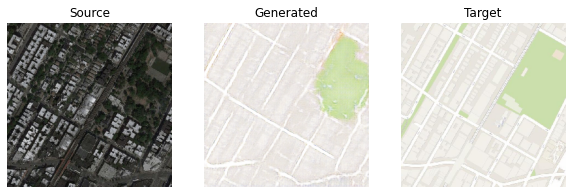

step[8100], d1_loss:[0.246] d2_loss:[0.121] generator_loss[7.939]


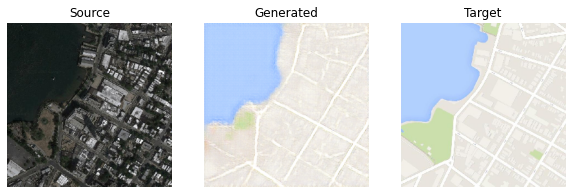

step[8150], d1_loss:[0.297] d2_loss:[0.105] generator_loss[10.278]


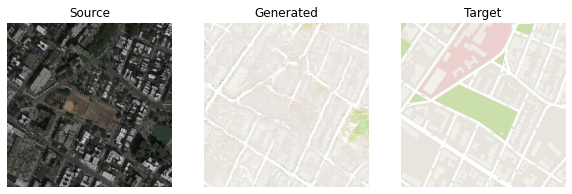

step[8200], d1_loss:[0.598] d2_loss:[0.329] generator_loss[7.598]


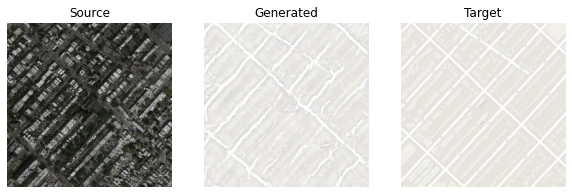

step[8250], d1_loss:[0.145] d2_loss:[0.222] generator_loss[10.291]


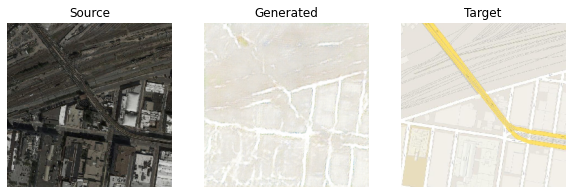

step[8300], d1_loss:[0.028] d2_loss:[0.061] generator_loss[12.074]


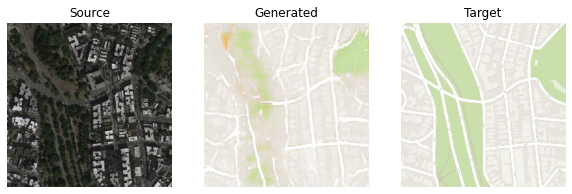

step[8350], d1_loss:[0.047] d2_loss:[0.488] generator_loss[10.461]


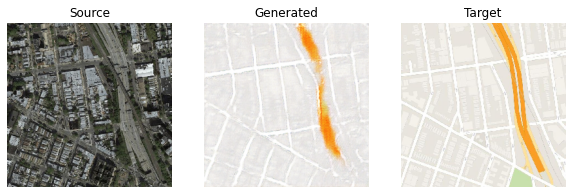

step[8400], d1_loss:[0.619] d2_loss:[0.150] generator_loss[7.552]


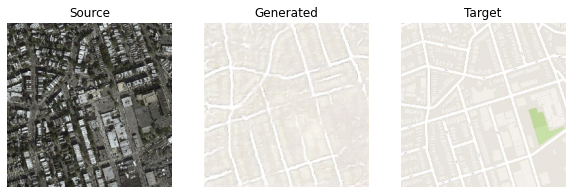

step[8450], d1_loss:[0.018] d2_loss:[0.046] generator_loss[12.537]


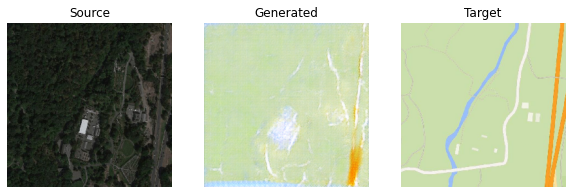

step[8500], d1_loss:[0.120] d2_loss:[0.184] generator_loss[8.976]


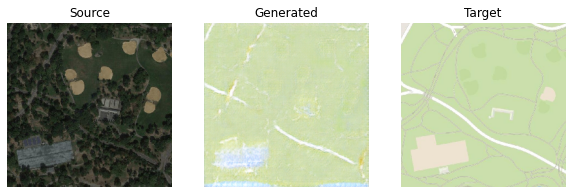

step[8550], d1_loss:[0.099] d2_loss:[0.541] generator_loss[7.848]


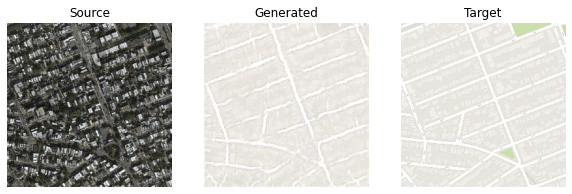

step[8600], d1_loss:[0.078] d2_loss:[0.108] generator_loss[9.528]


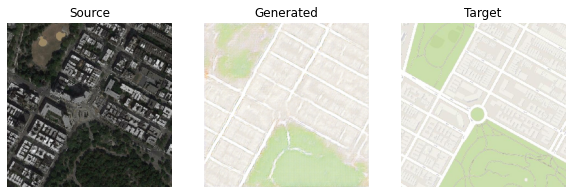

step[8650], d1_loss:[0.038] d2_loss:[0.168] generator_loss[10.346]


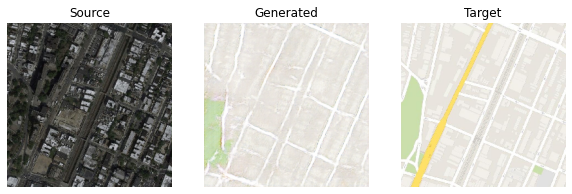

step[8700], d1_loss:[0.381] d2_loss:[0.100] generator_loss[7.828]


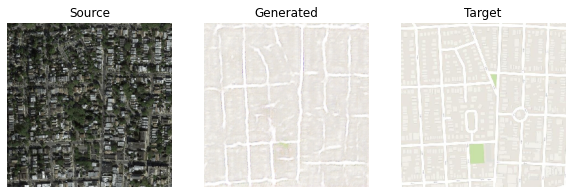

step[8750], d1_loss:[0.030] d2_loss:[0.077] generator_loss[15.207]


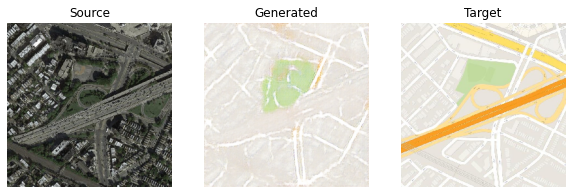

step[8800], d1_loss:[0.128] d2_loss:[0.472] generator_loss[7.554]


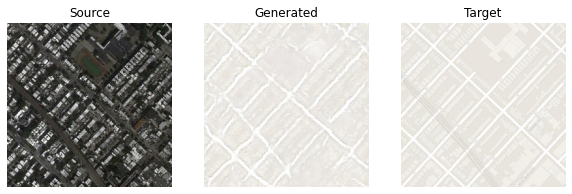

step[8850], d1_loss:[0.096] d2_loss:[0.186] generator_loss[8.619]


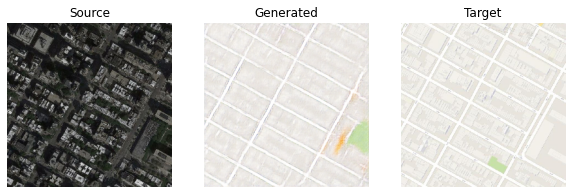

step[8900], d1_loss:[1.404] d2_loss:[0.076] generator_loss[6.242]


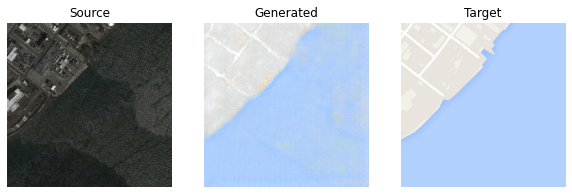

step[8950], d1_loss:[0.006] d2_loss:[0.304] generator_loss[12.973]


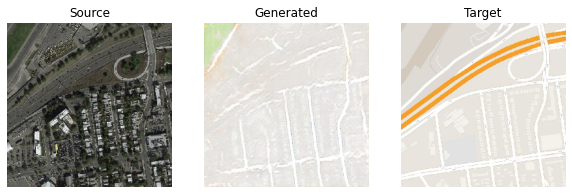

step[9000], d1_loss:[0.154] d2_loss:[0.157] generator_loss[7.420]


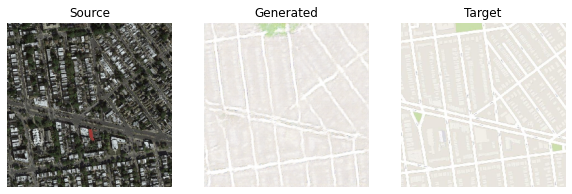

step[9050], d1_loss:[0.015] d2_loss:[0.135] generator_loss[10.449]


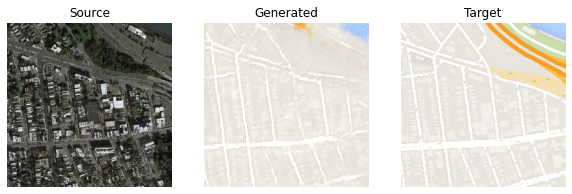

step[9100], d1_loss:[0.635] d2_loss:[0.255] generator_loss[7.426]


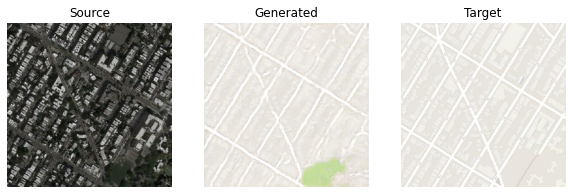

step[9150], d1_loss:[0.148] d2_loss:[0.252] generator_loss[11.244]


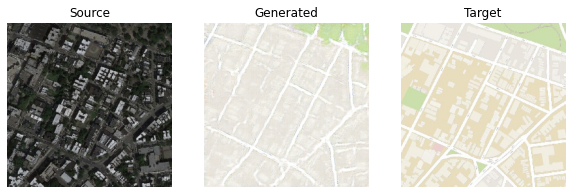

step[9200], d1_loss:[0.008] d2_loss:[0.099] generator_loss[16.531]


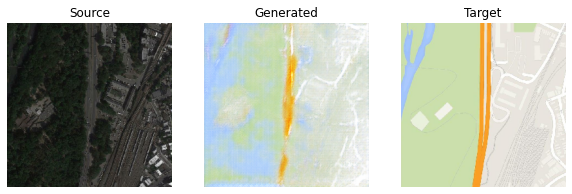

step[9250], d1_loss:[0.269] d2_loss:[0.168] generator_loss[4.987]


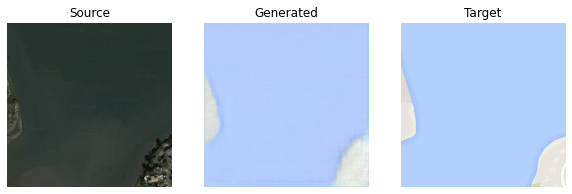

step[9300], d1_loss:[0.172] d2_loss:[0.110] generator_loss[10.799]


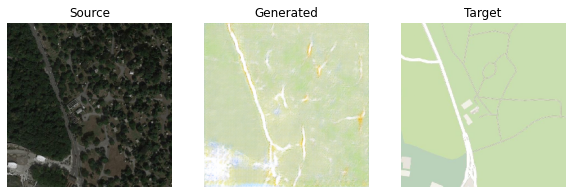

step[9350], d1_loss:[0.490] d2_loss:[0.175] generator_loss[8.410]


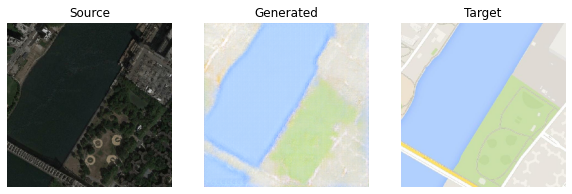

step[9400], d1_loss:[0.063] d2_loss:[0.367] generator_loss[10.572]


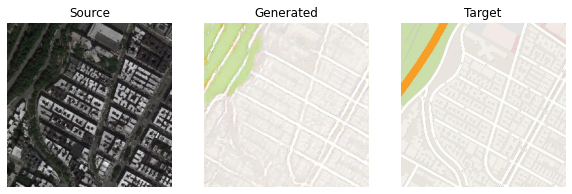

step[9450], d1_loss:[0.057] d2_loss:[0.097] generator_loss[12.767]


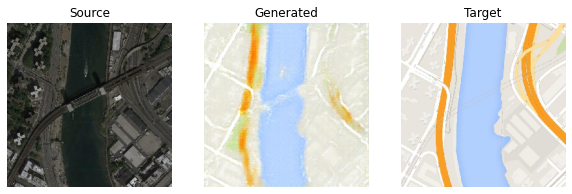

step[9500], d1_loss:[0.615] d2_loss:[0.207] generator_loss[6.851]


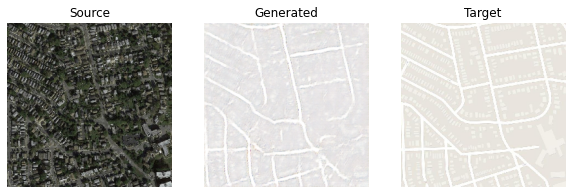

step[9550], d1_loss:[0.104] d2_loss:[0.342] generator_loss[8.034]


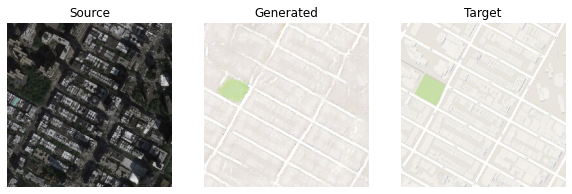

step[9600], d1_loss:[0.194] d2_loss:[0.058] generator_loss[9.170]


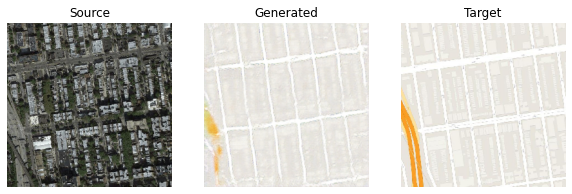

step[9650], d1_loss:[0.091] d2_loss:[0.100] generator_loss[8.476]


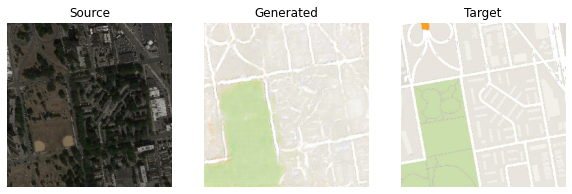

step[9700], d1_loss:[0.023] d2_loss:[0.158] generator_loss[10.663]


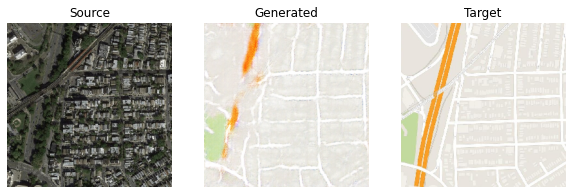

step[9750], d1_loss:[0.060] d2_loss:[0.045] generator_loss[4.429]


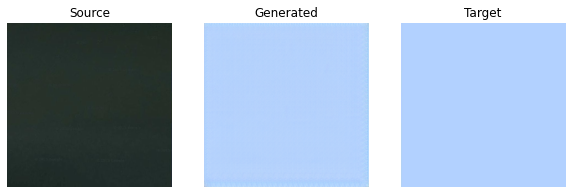

step[9800], d1_loss:[0.358] d2_loss:[0.358] generator_loss[7.961]


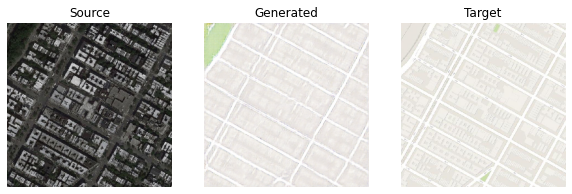

step[9850], d1_loss:[0.049] d2_loss:[0.072] generator_loss[14.980]


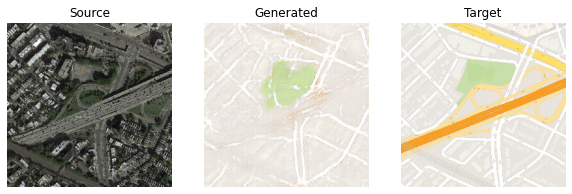

step[9900], d1_loss:[0.375] d2_loss:[0.155] generator_loss[11.878]


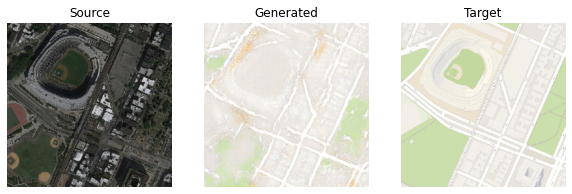

step[9950], d1_loss:[0.350] d2_loss:[0.344] generator_loss[8.063]


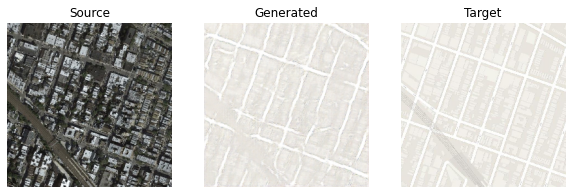

step[10000], d1_loss:[0.055] d2_loss:[0.096] generator_loss[14.885]


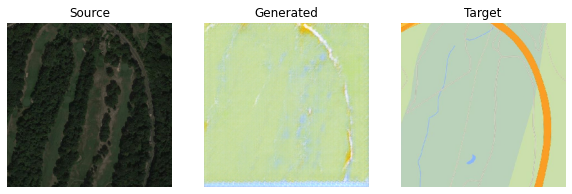

step[10050], d1_loss:[0.054] d2_loss:[0.092] generator_loss[8.901]


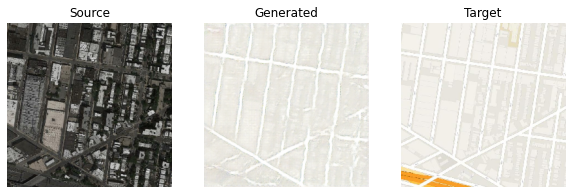

step[10100], d1_loss:[0.947] d2_loss:[0.083] generator_loss[8.547]


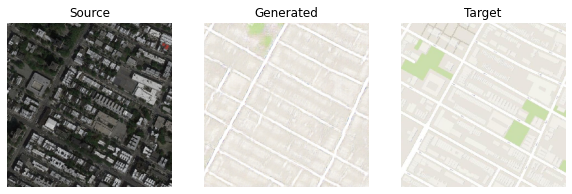

step[10150], d1_loss:[0.018] d2_loss:[0.061] generator_loss[13.101]


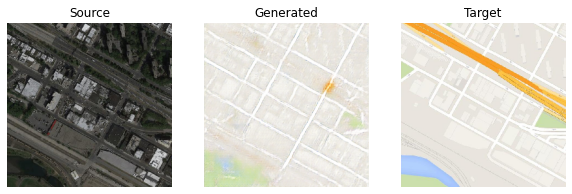

step[10200], d1_loss:[0.695] d2_loss:[0.114] generator_loss[7.854]


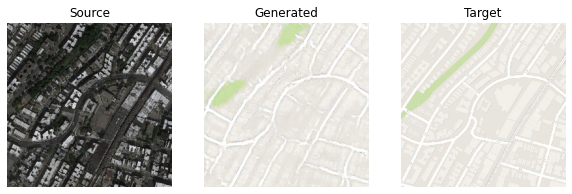

step[10250], d1_loss:[0.238] d2_loss:[0.111] generator_loss[7.755]


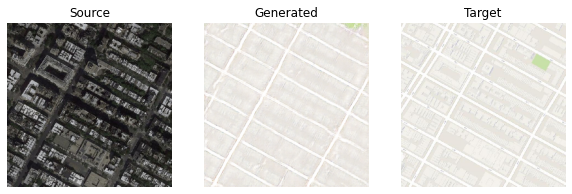

step[10300], d1_loss:[0.074] d2_loss:[0.065] generator_loss[12.162]


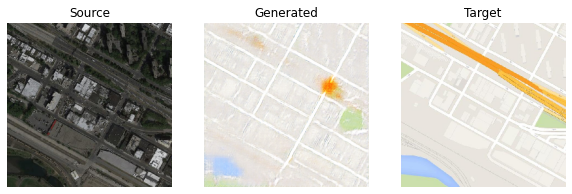

step[10350], d1_loss:[0.008] d2_loss:[0.168] generator_loss[24.990]


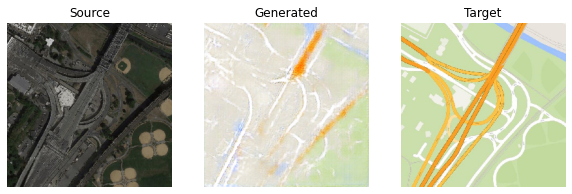

step[10400], d1_loss:[0.201] d2_loss:[0.948] generator_loss[7.298]


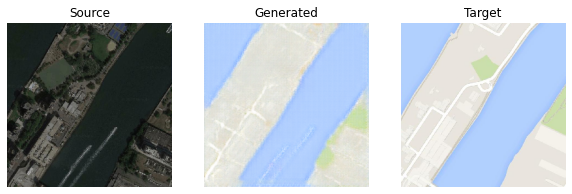

step[10450], d1_loss:[0.067] d2_loss:[0.091] generator_loss[13.451]


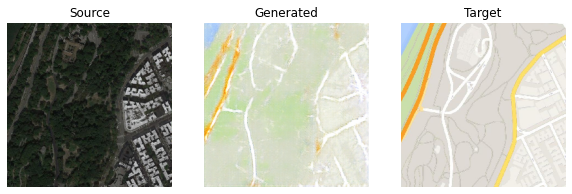

step[10500], d1_loss:[0.021] d2_loss:[0.457] generator_loss[12.042]


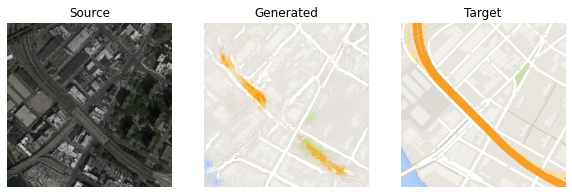

step[10550], d1_loss:[0.399] d2_loss:[0.064] generator_loss[8.713]


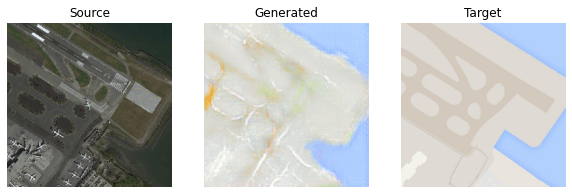

step[10600], d1_loss:[0.297] d2_loss:[0.075] generator_loss[11.108]


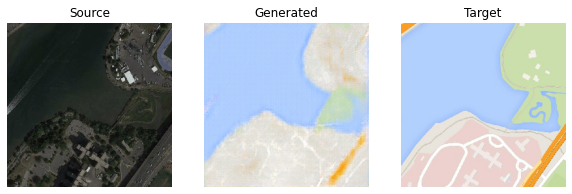

step[10650], d1_loss:[0.046] d2_loss:[0.153] generator_loss[9.770]


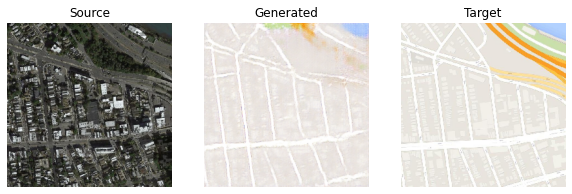

step[10700], d1_loss:[0.016] d2_loss:[0.270] generator_loss[12.270]


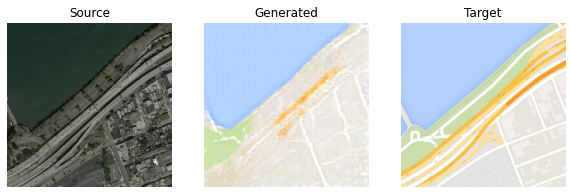

step[10750], d1_loss:[0.065] d2_loss:[0.171] generator_loss[8.144]


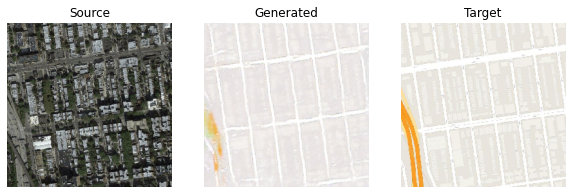

step[10800], d1_loss:[0.164] d2_loss:[0.308] generator_loss[11.277]


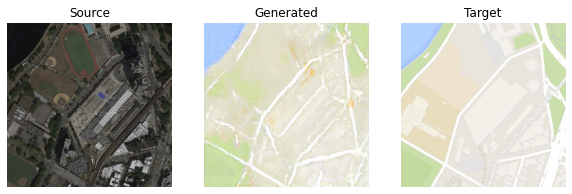

step[10850], d1_loss:[0.033] d2_loss:[0.118] generator_loss[17.430]


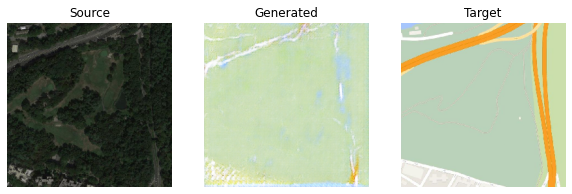

step[10900], d1_loss:[0.058] d2_loss:[0.109] generator_loss[10.574]


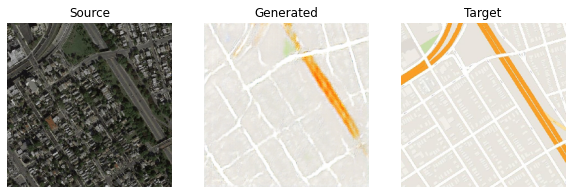

step[10950], d1_loss:[0.140] d2_loss:[0.113] generator_loss[6.962]


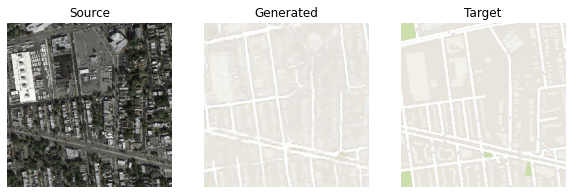

>Saved: plot_010960.png and model_010960.h5
Execution time:  0:28:28.792145


In [18]:
# Get input image shape, e.g., (256, 256, 3)
image_shape = src_images.shape[1:]

# Define the discriminator and generator models
d_model = define_discriminator(image_shape)
g_model = define_generator(image_shape)

# Define the combined GAN model
gan_model = define_gan(g_model, d_model, image_shape)

# Prepare dataset: satellite images and corresponding Google Maps
data = [src_images, tar_images]

# Preprocess images: scale from [0,255] to [-1,1] for training
def preprocess_data(data):
    X1, X2 = data[0], data[1]
    X1 = (X1 - 127.5) / 127.5
    X2 = (X2 - 127.5) / 127.5
    return [X1, X2]

dataset = preprocess_data(data)

# Choose whether to train a new model or use a pretrained model
user_choice = 'train model'

if user_choice == 'train model':
    start_time = datetime.now()
    train(d_model, g_model, gan_model, dataset, n_epochs=10, n_batch=1)
    stop_time = datetime.now()
    execution_time = stop_time - start_time
    print("Execution time: ", execution_time)
else:
    print("Using pretrained model directly")


In [ ]:

# Load the pre-trained model
model = load_model('Satellite2Map.h5')

# Function to plot images and calculate SSIM and PSNR for a single pair
def plot_images(src_img, gen_img, tar_img):
    images = np.vstack((src_img, gen_img, tar_img))
    # Rescale images from [-1, 1] to [0, 1]
    images = (images + 1) / 2.0
    titles = ['Source', 'Generated', 'Expected']
    
    # Plot images row by row
    for i in range(len(images)):
        plt.subplot(1, 3, 1 + i)
        plt.axis('off')
        plt.imshow(images[i])
        plt.title(titles[i])

    # Resize images if they are too small
    tar_img_resized = resize(tar_img[0], (64, 64), mode='reflect', anti_aliasing=True)
    gen_img_resized = resize(gen_img[0], (64, 64), mode='reflect', anti_aliasing=True)

    # Rescale images to [0, 255] range for SSIM and PSNR
    tar_img_uint8 = ((tar_img_resized + 1) * 127.5).astype(np.uint8)
    gen_img_uint8 = ((gen_img_resized + 1) * 127.5).astype(np.uint8)

    # Calculate SSIM between generated and target images
    ssim_score, _ = ssim(tar_img_uint8, gen_img_uint8, full=True, multichannel=True, channel_axis=2)
    
    # Calculate PSNR between generated and target images
    psnr_score = psnr(tar_img_uint8, gen_img_uint8)

    return ssim_score, psnr_score

# Assume dataset contains X1 and X2 where X1 is the source images and X2 is the target images
[X1, X2] = dataset

# Initialize lists to store SSIM and PSNR scores
ssim_scores = []
psnr_scores = []

# Process 200 random pairs of images
for _ in range(200):
    ix = randint(0, len(X1), 1)
    src_image, tar_image = X1[ix], X2[ix]
    print(_)
    # Generate image from source
    gen_image = model.predict(src_image)

    # Calculate SSIM and PSNR for this pair and add them to the lists
    ssim_score, psnr_score = plot_images(src_image, gen_image, tar_image)
    ssim_scores.append(ssim_score)
    psnr_scores.append(psnr_score)

# Calculate the average SSIM and PSNR scores across all 200 pairs
average_ssim = np.mean(ssim_scores)
average_psnr = np.mean(psnr_scores)

print(f"Average SSIM for 200 image pairs: {average_ssim:.4f}")
print(f"Average PSNR for 200 image pairs: {average_psnr:.4f}")


0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
Average SSIM for 200 image pairs: 0.8021
Average PSNR for 200 image pairs: 28.9182
